# The Battle of Neighborhoods: NY vs San Diego

# LIBRARIES

In [1]:
import numpy as np

import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
from pandas import ExcelWriter
from pandas import ExcelFile

import json

import requests
from pandas.io.json import json_normalize

%matplotlib inline
import matplotlib as mpl
mpl.style.use('ggplot')
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.cm as cm
import matplotlib.colors as colors

from sklearn.cluster import KMeans

from math import sqrt

!pip install folium
import folium

!pip install seaborn
import seaborn as sns

!pip install geopy
from geopy.geocoders import Nominatim

!pip install shapely
import shapely.wkt

!pip install camelot-py[cv]
import camelot

print('Libraries imported.')

     |████████████████████████████████| 102kB 9.5MB/s ta 0:00:011
     |████████████████████████████████| 1.8MB 9.4MB/s eta 0:00:01
     |████████████████████████████████| 51kB 8.4MB/s eta 0:00:011
     |████████████████████████████████| 5.6MB 7.4MB/s eta 0:00:01
     |████████████████████████████████| 81kB 30.5MB/s eta 0:00:01
     |████████████████████████████████| 28.2MB 47.2MB/s eta 0:00:01
     |████████████████████████████████| 13.7MB 18.6MB/s eta 0:00:01
  Stored in directory: /home/dsxuser/.cache/pip/wheels/53/84/19/35bc977c8bf5f0c23a8a011aa958acd4da4bbd7a229315c1b7
Successfully built PyPDF2
Libraries imported.


# DATA

### New York

In [2]:
#data download
!wget -q -O 'nyu-2451-34572-geojson.json' https://geo.nyu.edu/download/file/nyu-2451-34572-geojson.json

with open('nyu-2451-34572-geojson.json') as json_data:
    ny_data = json.load(json_data)

#define a new variable that includes above data
ny_neighborhoods = ny_data['features']

display(ny_neighborhoods[0])



#transform the data into a pandas dataframe

#1.define the dataframe columns
ny_column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude']

#2.dataframe
ny = pd.DataFrame(columns=ny_column_names)

#3.loop through the data and fill the dataframe one row at a time
for data in ny_neighborhoods:
    borough = ny_neighborhood_name = data['properties']['borough']
    ny_neighborhood_name = data['properties']['name']
    
    ny_neighborhood_latlon = data['geometry']['coordinates']
    ny_neighborhood_lat = ny_neighborhood_latlon[1]
    ny_neighborhood_lon = ny_neighborhood_latlon[0]
    
    ny = ny.append({'Borough':borough,
                   'Neighborhood':ny_neighborhood_name,
                   'Latitude':ny_neighborhood_lat,
                   'Longitude':ny_neighborhood_lon}, ignore_index=True)
display(ny.head())

print('The dataframe has {} boroughs and {} neighborhoods.'.format(
        len(ny['Borough'].unique()),
        ny.shape[0]
    )
)

{'type': 'Feature',
 'id': 'nyu_2451_34572.1',
 'geometry': {'type': 'Point',
  'coordinates': [-73.84720052054902, 40.89470517661]},
 'geometry_name': 'geom',
 'properties': {'name': 'Wakefield',
  'stacked': 1,
  'annoline1': 'Wakefield',
  'annoline2': None,
  'annoline3': None,
  'annoangle': 0.0,
  'borough': 'Bronx',
  'bbox': [-73.84720052054902,
   40.89470517661,
   -73.84720052054902,
   40.89470517661]}}

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


The dataframe has 5 boroughs and 306 neighborhoods.


**Only interested in MANHATTAN**

In [3]:
manhattan = ny[ny['Borough'] == 'Manhattan'].reset_index(drop=True)
manhattan = manhattan[['Neighborhood', 'Latitude', 'Longitude']]
display(manhattan.head())

print('The dataframe has {} neighborhoods.'.format(manhattan.shape[0]))

,Neighborhood,Latitude,Longitude
0,Marble Hill,40.876551,-73.910660
1,Chinatown,40.715618,-73.994279
2,Washington Heights,40.851903,-73.936900
3,Inwood,40.867684,-73.921210
4,Hamilton Heights,40.823604,-73.949688


The dataframe has 40 neighborhoods.


### San Diego

In [4]:
#Data Download
!wget -q -O 'gn-san-diego.geojson' https://github.com/blackmad/neighborhoods/raw/master/gn-san-diego.geojson

with open('gn-san-diego.geojson') as json_data:
    sd_data = json.load(json_data)
    
#define a new variable that includes the above data
sd_neighborhoods = sd_data['features']

print(sd_neighborhoods[0])



#transform the data into a pandas dataframe

#1.define the dataframe columns
sd_column_names = ['Neighborhood', 'Latitude', 'Longitude']

#2.dataframe
sd = pd.DataFrame(columns=sd_column_names)

#3.loop through the data and fill the dataframe one row at a time
for data in sd_neighborhoods:
    sd_neighborhood_name = data['properties']['name']
    
    sd_neighborhood_lat = data['properties']['lat']
    sd_neighborhood_lon = data['properties']['lng']
    
    sd = sd.append({'Neighborhood':sd_neighborhood_name,
                   'Latitude':sd_neighborhood_lat,
                   'Longitude':sd_neighborhood_lon}, ignore_index=True)
display(sd.head())

print('The dataframe has {} neighborhoods'.format(sd.shape[0]))

{'type': 'Feature', 'properties': {'fclass': 'P', 'name': 'Qualcomm', 'countryCode': 'US', 'geonameid': None, 'created_at': '2013-02-16T03:11:02.653Z', 'cartodb_id': 1, 'updated_at': '2013-02-16T03:11:19.974Z', 'fcode': 'PPLX', 'lat': 32.783321677093554, 'parents': '5391811', 'adminCode4': '', 'lng': -117.11973779002166, 'adminCode1': 'CA', 'adminCode2': '073', 'adminCode3': ''}, 'geometry': {'type': 'MultiPolygon', 'coordinates': [[[[-117.1145, 32.7862], [-117.114503, 32.786187], [-117.114506, 32.786173], [-117.114509, 32.78616], [-117.114512, 32.786146], [-117.114515, 32.786133], [-117.114518, 32.786119], [-117.11452, 32.786106], [-117.114523, 32.786092], [-117.114526, 32.786079], [-117.114528, 32.786065], [-117.11453, 32.786051], [-117.114533, 32.786038], [-117.114535, 32.786024], [-117.114537, 32.786011], [-117.11454, 32.785997], [-117.114542, 32.785983], [-117.114544, 32.78597], [-117.114546, 32.785956], [-117.114547, 32.785942], [-117.114549, 32.785929], [-117.114551, 32.785915],

,Neighborhood,Latitude,Longitude
0,Qualcomm,32.783322,-117.119738
1,Egger Highlands,32.587312,-117.100488
2,Old Town,32.754602,-117.195528
3,Morena,32.769888,-117.193218
4,Midtown,32.739864,-117.175020


The dataframe has 124 neighborhoods


## Neighborhood Map

In [5]:
#get the geographical cooridnates of Manhattan
address = 'Manhattan, NY'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
ny_latitude = location.latitude
ny_longitude = location.longitude
print('The geographical coordinate of Manhattan are {}, {}.'.format(ny_latitude, ny_longitude))


#get the geographical cooridnates of San Diego
address = 'San Diego, CA'

geolocator = Nominatim(user_agent="sd_explorer")
location = geolocator.geocode(address)
sd_latitude = location.latitude
sd_longitude = location.longitude

print('The geographical coordinate of San Diego are {}, {}.'.format(sd_latitude, sd_longitude))

print('\n')


#Visualize - MAP
#create map of Manhattan using latitude and longitude values
map_manhattan = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=11)

#add markers to map
for lat, lng, label in zip(manhattan['Latitude'], manhattan['Longitude'], 
                           manhattan['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_manhattan)  
    
display(map_manhattan)

#create mp of San Diego using latitude and longitude values
map_sd = folium.Map(location=[sd_latitude, sd_longitude], zoom_start=10)

#add markers to map
for lat, lng, neighborhood in zip(sd['Latitude'], sd['Longitude'],
                                  sd['Neighborhood']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_sd)

display(map_sd)

The geographical coordinate of Manhattan are 40.7896239, -73.9598939.
The geographical coordinate of San Diego are 32.7174209, -117.1627714.




# EXPLORE NEIGHBORHOODS

by utilizing the Foursquare API:

1. define credentials
2. create a function to repeat the same process to all the neighborhoods in San Diego
3. create the API request URL
4. make the GET request
5. return only relevant information for each nearby venue

In [8]:
# The code was removed by Watson Studio for sharing.

In [10]:
# 2.Create a function to repeat the same process to all the neighborhoods in San Diego

def getNearbyVenues(names, latitudes, longitudes):
    radius = 500
    LIMIT = 100
    venues_list = []
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
        
        #3. Create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
        
        #4. Make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        #5. Return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])
        
        nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
        nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    return(nearby_venues)

print("---- MANHATTAN ----")

#manhattan
manhattan_venues = getNearbyVenues(names = manhattan['Neighborhood'],
                                   latitudes = manhattan['Latitude'],
                                   longitudes = manhattan['Longitude']
                                  )

print('\n')
print("---- SAN DIEGO ----")

#San Diego
sd_venues = getNearbyVenues(names = sd['Neighborhood'],
                           latitudes = sd['Latitude'],
                           longitudes = sd['Longitude']
                           )

print('\n')
print("TABLE - MANHATTAN")
display(manhattan_venues.head())
#Check data shape for manhattan
print("Manhattan venues:", manhattan_venues.shape)


print('\n')
print("TABLE - SAN DIEGO")
display(sd_venues.head())
#Check data shape for san diego
print("San Diego venues:", sd_venues.shape)

---- MANHATTAN ----
Marble Hill
Chinatown
Washington Heights
Inwood
Hamilton Heights
Manhattanville
Central Harlem
East Harlem
Upper East Side
Yorkville
Lenox Hill
Roosevelt Island
Upper West Side
Lincoln Square
Clinton
Midtown
Murray Hill
Chelsea
Greenwich Village
East Village
Lower East Side
Tribeca
Little Italy
Soho
West Village
Manhattan Valley
Morningside Heights
Gramercy
Battery Park City
Financial District
Carnegie Hill
Noho
Civic Center
Midtown South
Sutton Place
Turtle Bay
Tudor City
Stuyvesant Town
Flatiron
Hudson Yards


---- SAN DIEGO ----
Qualcomm
Egger Highlands
Old Town
Morena
Midtown
Fairmont Village
Lincoln Park
Grantville
Del Cerro
San Pasqual
Ocean Beach
Mission Bay Park
La Jolla
Torrey Pines
Bay Ho
Linda Vista
Castle
Valencia Park
College East
Clairemont Mesa East
Tierrasanta
Scripps Ranch
Rancho Encantada
Mission Beach
Miramar Ranch North
Mission Bay
North City
Loma Portal
Gaslamp
Hillcrest
North Park
Southcrest
Teralta West
Mt Hope
Teralta East
Ridgeview/Webster
P

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Marble Hill,40.876551,-73.91066,Arturo's,40.874412,-73.910271,Pizza Place
1,Marble Hill,40.876551,-73.91066,Bikram Yoga,40.876844,-73.906204,Yoga Studio
2,Marble Hill,40.876551,-73.91066,Tibbett Diner,40.880404,-73.908937,Diner
3,Marble Hill,40.876551,-73.91066,Starbucks,40.877531,-73.905582,Coffee Shop
4,Marble Hill,40.876551,-73.91066,Dunkin',40.877136,-73.906666,Donut Shop


Manhattan venues: (3017, 7)


TABLE - SAN DIEGO


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Qualcomm,32.783322,-117.119738,SDCCU Stadium,32.783035,-117.119493,Football Stadium
1,Qualcomm,32.783322,-117.119738,Qualcomm Stadium Swap Meet,32.784975,-117.121750,Flea Market
2,Qualcomm,32.783322,-117.119738,E3 All Stars Tailgate,32.784613,-117.122946,Football Stadium
3,Egger Highlands,32.587312,-117.100488,Jalisco Cafe,32.583549,-117.097720,Mexican Restaurant
4,Egger Highlands,32.587312,-117.100488,Rally's,32.583572,-117.099726,Fast Food Restaurant


San Diego venues: (1965, 7)


In [11]:
#count number of venues
table1 = manhattan_venues.groupby('Neighborhood').count().reset_index()
table2 = sd_venues.groupby('Neighborhood').count().reset_index()

#count unique categories
display(table1.head())
print('Manhattan - there are {} unique categories.'.format(len(manhattan_venues['Venue Category'].unique())))

display(table2.head())
print('San Diego - there are {} unique categories.'.format(len(sd_venues['Venue Category'].unique())))

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Battery Park City,62,62,62,62,62,62
1,Carnegie Hill,84,84,84,84,84,84
2,Central Harlem,46,46,46,46,46,46
3,Chelsea,100,100,100,100,100,100
4,Chinatown,100,100,100,100,100,100


Manhattan - there are 329 unique categories.


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Adams North,1,1,1,1,1,1
1,Allied Gardens,1,1,1,1,1,1
2,Alta Vista,2,2,2,2,2,2
3,Azalea/Hollywood Park,2,2,2,2,2,2
4,Balboa Park,44,44,44,44,44,44


San Diego - there are 276 unique categories.


# EXPLORE & ANALYZE NEIGHBORHOODS WITH VENUES

In [12]:
#one hot encoding - representation of categorical variables as binary vectors
manhattan_onehot = pd.get_dummies(manhattan_venues[['Venue Category']], prefix="", prefix_sep="")
sd_onehot = pd.get_dummies(sd_venues[['Venue Category']], prefix="", prefix_sep="")

#add neighborhood column to the first column
manhattan_onehot.insert(loc=0, column='Neighborhood', value=manhattan_venues['Neighborhood'])

sd_onehot.drop(['Neighborhood'], axis=1, inplace=True)
sd_onehot.insert(loc=0, column='Neighborhood', value=sd_venues['Neighborhood'])

display(manhattan_onehot.head())
print("Manhattan:", manhattan_onehot.shape)

print('\n')

display(sd_onehot.head())
print("San Diego:", sd_onehot.shape)

,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Basketball Stadium,Beer Bar,Beer Garden,Beer Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Bridal Shop,Bridge,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Community Center,Concert Hall,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Financial or Legal Service,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Laundry Service,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Mac & Cheese Joint,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Non-Profit,Noodle House,North Indian Restaurant,Office,Opera House,Optical Shop,Organic Grocery,Other Great Outdoors,Outdoor Sculpture,Outdoors & Recreation,Paella Restaurant,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Photography Studio,Physical Therapist,Pie Shop,Pier,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pub,Public Art,Ramen Restaurant,Record Shop,Rental Car Location,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Rock Club,Roof Deck,Russian Restaurant,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Smoke Shop,Snack Place,Soba Restauran

Manhattan: (3017, 330)




,Neighborhood,ATM,Accessories Store,American Restaurant,Amphitheater,Antique Shop,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Store,Big Box Store,Bike Shop,Board Shop,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Country Dance Club,Credit Union,Cruise,Cupcake Shop,Currency Exchange,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dry Cleaner,Duty-free Shop,Eastern European Restaurant,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Fishing Spot,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Truck,Football Stadium,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gym Pool,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Theater,Insurance Office,Intersection,Irish Pub,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Latin American Restaurant,Laundromat,Light Rail Station,Lingerie Store,Liquor Store,Locksmith,Lounge,Marijuana Dispensary,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Movie Theater,Museum,Music Venue,Nail Salon,New American Restaurant,Nightclub,Noodle House,Optical Shop,Organic Grocery,Other Repair Shop,Paper / Office Supplies Store,Park,Pawn Shop,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Studio,Piano Bar,Pie Shop,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pop-Up Shop,Portuguese Restaurant,Print Shop,Pub,Ramen Restaurant,Record Shop,Recording Studio,Recreation Center,Rental Car Location,Rental Service,Residential Building (Apartment / Condo),Resort,Restaurant,Rock Club,Roller Rink,Salon / Barbershop,Sandwich Place,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shipping Store,Shoe Store,Shopping Mall,Shopping Plaza,Skate Park,Smoke Shop,Snack Place,Soccer Field,South American Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Stables,State / Provincial Park,Steakhouse,Street Food Gathering,Supermarket,Supplement Shop,Sushi Restaurant,Taco Place,Tanning Salon,Tapas Restaurant,Tattoo Parlor,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Theme Restaurant,Thrift / Vintage Store,Tiki Bar,Tourist Information Center,Trail,Train Station,Travel & Transport,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio,Zoo Exhibi

San Diego: (1965, 276)


In [13]:
#group rows by neighborhood and calculate the mean of the frequency of occurrence of each venue category
manhattan_grouped = manhattan_onehot.groupby('Neighborhood').mean().reset_index()
sd_grouped = sd_onehot.groupby('Neighborhood').mean().reset_index()

display(manhattan_grouped.head()) 
print("Manhattan data shape:", manhattan_grouped.shape)
display(sd_grouped.head())
print("San Diego data shape:", sd_grouped.shape)

,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Basketball Stadium,Beer Bar,Beer Garden,Beer Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Bridal Shop,Bridge,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Community Center,Concert Hall,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Financial or Legal Service,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Laundry Service,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Mac & Cheese Joint,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Non-Profit,Noodle House,North Indian Restaurant,Office,Opera House,Optical Shop,Organic Grocery,Other Great Outdoors,Outdoor Sculpture,Outdoors & Recreation,Paella Restaurant,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Photography Studio,Physical Therapist,Pie Shop,Pier,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pub,Public Art,Ramen Restaurant,Record Shop,Rental Car Location,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Rock Club,Roof Deck,Russian Restaurant,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Smoke Shop,Snack Place,Soba Restauran

Manhattan data shape: (40, 330)


,Neighborhood,ATM,Accessories Store,American Restaurant,Amphitheater,Antique Shop,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Store,Big Box Store,Bike Shop,Board Shop,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Country Dance Club,Credit Union,Cruise,Cupcake Shop,Currency Exchange,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dry Cleaner,Duty-free Shop,Eastern European Restaurant,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Fishing Spot,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Truck,Football Stadium,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gym Pool,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Theater,Insurance Office,Intersection,Irish Pub,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Latin American Restaurant,Laundromat,Light Rail Station,Lingerie Store,Liquor Store,Locksmith,Lounge,Marijuana Dispensary,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Movie Theater,Museum,Music Venue,Nail Salon,New American Restaurant,Nightclub,Noodle House,Optical Shop,Organic Grocery,Other Repair Shop,Paper / Office Supplies Store,Park,Pawn Shop,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Studio,Piano Bar,Pie Shop,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pop-Up Shop,Portuguese Restaurant,Print Shop,Pub,Ramen Restaurant,Record Shop,Recording Studio,Recreation Center,Rental Car Location,Rental Service,Residential Building (Apartment / Condo),Resort,Restaurant,Rock Club,Roller Rink,Salon / Barbershop,Sandwich Place,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shipping Store,Shoe Store,Shopping Mall,Shopping Plaza,Skate Park,Smoke Shop,Snack Place,Soccer Field,South American Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Stables,State / Provincial Park,Steakhouse,Street Food Gathering,Supermarket,Supplement Shop,Sushi Restaurant,Taco Place,Tanning Salon,Tapas Restaurant,Tattoo Parlor,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Theme Restaurant,Thrift / Vintage Store,Tiki Bar,Tourist Information Center,Trail,Train Station,Travel & Transport,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio,Zoo Exhibi

San Diego data shape: (116, 276)


In [14]:
#print each neighborhood in manhattan & san diego along with the top 5 most common venues
#num_top_venues = 5

#manhattan
#for hood in manhattan_grouped['Neighborhood']:
    #print("----"+hood+"----")
    #m_temp = manhattan_grouped[manhattan_grouped['Neighborhood'] == hood].T.reset_index()
    #m_temp.columns = ['venue', 'freq']
    #m_temp = m_temp.iloc[1:]
    #m_temp['freq'] = m_temp['freq'].astype(float)
    #m_temp = m_temp.round({'freq':2})
    #print(m_temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    #print('\n')
    
#san diego
#for hood in sd_grouped['Neighborhood']:
    #print("----"+hood+"----")
    #sd_temp = sd_grouped[sd_grouped['Neighborhood'] == hood].T.reset_index()
    #sd_temp.columns = ['venue', 'freq']
    #sd_temp = sd_temp.iloc[1:]
    #sd_temp['freq'] = sd_temp['freq'].astype(float)
    #sd_temp = sd_temp.round({'freq':2})
    #print(sd_temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    #print('\n')
    

#The top 10 most common venues in Manhattan & San Diego
#1.write a function to sort the venues in descending order
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]


#2.create the new dataframe and display the top 10 venues for each neighborhood
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

#3.create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))
        
#4_manhattan create a new dataframe for Manhattan
m_neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
m_neighborhoods_venues_sorted['Neighborhood'] = manhattan_grouped['Neighborhood']

for ind in np.arange(manhattan_grouped.shape[0]):
    m_neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(manhattan_grouped.iloc[ind, :], num_top_venues)
        
#4_sandiego create a new dataframe for San Diego
sd_neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
sd_neighborhoods_venues_sorted['Neighborhood'] = sd_grouped['Neighborhood']

for ind in np.arange(sd_grouped.shape[0]):
    sd_neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(sd_grouped.iloc[ind, :], num_top_venues)

#5. display
print("Manhattan:")
display(m_neighborhoods_venues_sorted.head())

print('\n')

print("San Diego:")
display(sd_neighborhoods_venues_sorted.head())

Manhattan:


,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Battery Park City,Park,Hotel,Wine Shop,Memorial Site,Coffee Shop,Gym,Boat or Ferry,Playground,Plaza,Shopping Mall
1,Carnegie Hill,Coffee Shop,Pizza Place,Gym,Café,Bookstore,Grocery Store,Japanese Restaurant,Yoga Studio,Wine Shop,Vietnamese Restaurant
2,Central Harlem,African Restaurant,Bar,Chinese Restaurant,French Restaurant,American Restaurant,Seafood Restaurant,Cosmetics Shop,Boutique,Beer Bar,Gym / Fitness Center
3,Chelsea,Art Gallery,Coffee Shop,Café,Ice Cream Shop,American Restaurant,Cycle Studio,Seafood Restaurant,Market,Theater,Bakery
4,Chinatown,Chinese Restaurant,Cocktail Bar,Bakery,Bubble Tea Shop,American Restaurant,Coffee Shop,Vietnamese Restaurant,Optical Shop,Salon / Barbershop,Spa




San Diego:


,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Adams North,Park,Farmers Market,Eastern European Restaurant,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Zoo Exhibit,Food
1,Allied Gardens,Recreation Center,Zoo Exhibit,Fast Food Restaurant,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Farmers Market,Filipino Restaurant
2,Alta Vista,Child Care Service,Gym,Zoo Exhibit,Duty-free Shop,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Farmers Market
3,Azalea/Hollywood Park,Restaurant,Park,Zoo Exhibit,Falafel Restaurant,Eastern European Restaurant,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Farmers Market
4,Balboa Park,Zoo Exhibit,Garden,Art Museum,Gift Shop,History Museum,Performing Arts Venue,Exhibit,Donut Shop,Museum,Fountain


## Chelsea, Manhattan
**I'm currently living in Chelsea, Manhattan and I love it here. I would like my new neighborhood to have similar venues as Chelsea does.**

1. Analyze Chelsea neighborhood
    - what kind of venues does Chelsea have?
    - Visualize


2. Measure similarities between Chelsea,Manhattan and neighborhoods in San Diego
    - based on the venues that Chelsea has
    - compare frequency and commoness of venues in Chelsea and neighborhoods that are similar to Chelsea


3. Desired Venues in my new neighborhood
    - venues in Chelsea, Manhattan
    - what venues does Chelsea not have?
    - what venues does San Diego have that Manhattan(or Chelsea) does not have?
    - Desired venues in my new neighborhood
    - analyze San Diego neighborhoods based on my desired venues


4. Find potential neighborhoods in San Diego based on
    - the measured similarity between Chelsea & San Diego neighborhoods
    - desired venue lists
    - visualization: Map
    - analyze each potential neighborhoods by venues

### Analyze Chelsea neighborhood

,American Restaurant,Art Gallery,Bagel Shop,Bakery,Bar,Beer Bar,Bookstore,Boutique,Café,Cheese Shop,Chinese Restaurant,Clothing Store,Club House,Coffee Shop,College Theater,Cosmetics Shop,Cupcake Shop,Cycle Studio,Electronics Store,Fish Market,Flea Market,French Restaurant,General Entertainment,Gift Shop,Grocery Store,Gym,Harbor / Marina,Health & Beauty Service,Hotel,Ice Cream Shop,Indie Theater,Italian Restaurant,Jewelry Store,Juice Bar,Liquor Store,Market,Mediterranean Restaurant,Movie Theater,Nightclub,Noodle House,Office,Park,Photography Studio,Physical Therapist,Pizza Place,Plaza,Pool,Ramen Restaurant,Restaurant,Roof Deck,Salon / Barbershop,Sandwich Place,Scenic Lookout,Seafood Restaurant,Shoe Store,Speakeasy,Supermarket,Sushi Restaurant,Taco Place,Theater,Wine Bar,Wine Shop,Women's Store
Neighborhood,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Chelsea,3.0,15.0,1.0,2.0,1.0,1.0,1.0,2.0,4.0,1.0,1.0,1.0,1.0,7.0,1.0,1.0,2.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,3.0,1.0,2.0,1.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,2.0,1.0,1.0,1.0


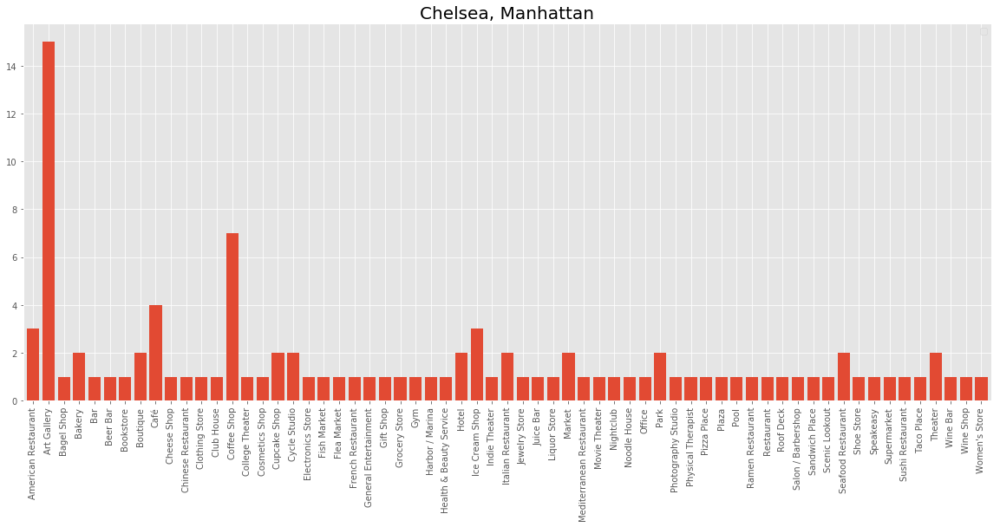

In [15]:
##what kind of venues does Chelsea have?
#Chlsea data
chelsea = manhattan_grouped.loc[manhattan_grouped['Neighborhood'] == 'Chelsea']

#remove every venue categories with '0'
chelsea_tr = chelsea.transpose()
chelsea_tr = chelsea_tr.drop(chelsea_tr[chelsea_tr[3] == 0].index)

#transpose back
chelsea_df = chelsea_tr.transpose()

#set Nieghborhood as index
chelsea_df.set_index('Neighborhood', inplace=True)

#check dtpye of the dataframes
#print(chelsea_df.dtypes)

#covert object dtypes to int for charts
chelsea_df = chelsea_df.astype('float')

#multiply by 100 to the numbers big enough
chelsea_df = (100*chelsea_df).round(1)
display(chelsea_df)


##visualization
#transpose the data for bar charts
chelsea_transp = chelsea_df.transpose()
#chelsea_transp.head

#bar chart
ax_c = chelsea_transp.plot(kind='bar', figsize=(20,8), width=0.8)
ax_c.set_title("Chelsea, Manhattan", fontsize=20)
ax_c.legend([])
plt.yticks()
plt.xticks()
plt.show()

### Measure similarities between Chelsea and neighborhoods in San Diego

In [16]:
##based on the venues that Chelsea has

#reindex the chelsea & sandiego dataframes for calculation
sd_grouped_indexed = sd_grouped.set_index([pd.Index(range(0,len(sd_grouped))), 'Neighborhood'])
manhattan_grouped_indexed = manhattan_grouped.set_index([pd.Index(range(0,len(manhattan_grouped))),'Neighborhood'])
##<- creating a multiIndex using an Index and a column

#Get differenct between each of the San Diego neighborhoods and Chelsea, Manhattan
sd_grouped_compared_to_chelsea = sd_grouped_indexed - manhattan_grouped_indexed.iloc[3]
sd_grouped_compared_to_chelsea #This formula took into the account that some columns in San Diego dataframe do not exist in Manhattan/Chelsea dataframe.
#It still included all the columns in the San Diego dataframe, but for the columns that don't co-exist in both dataframes, values were 'NaN'

#sqaure everything to unify -&+ numbers
sd_grouped_compared_to_chelsea = sd_grouped_compared_to_chelsea.pow(2)
sd_grouped_compared_to_chelsea.head()

#square root everything & sort ascending order
sd_grouped_compared_to_chelsea_sum = sd_grouped_compared_to_chelsea.sum(axis=1)
sd_grouped_distance = np.sqrt(sd_grouped_compared_to_chelsea_sum).sort_values(ascending=True)

sd_grouped_distance10 = pd.DataFrame(sd_grouped_distance.head(10))
sd_grouped_distance10.reset_index(inplace=True)
sd_grouped_distance10.set_index(['level_0'], inplace=True, drop=True)
sd_grouped_distance10

,Neighborhood,0
level_0,,
36,Gaslamp,0.183030
70,North Park,0.193883
23,Core-Columbia,0.196038
1,Allied Gardens,0.196469
104,Sunset Cliffs,0.196469
85,Rancho Encantada,0.196469
73,Ocean Crest,0.196469
42,Horton Plaza,0.203715
52,Little Italy,0.210613


In [17]:
##compare frequency and commoness of venues in Chelsea and neighborhoods that are similar to Chelsea

#Chelsea
print("---- Chelsea, Manhattan ----")
print("Venue Frequency:")
#1.frequency 
chelsea_freq = manhattan_grouped.iloc[[3]]
display(chelsea_freq)

print("Top 10 Common Venues:")
#2.common
chelsea_common = m_neighborhoods_venues_sorted.iloc[[3]] #chelsea dataframe we created earlier
display(chelsea_common)

print('\n')

print("---- 10 San Diego neighborhoods that are most similar to Chelsea, Manhattan ----")

#San Diego
#list of neighborhood index numbers
rows = sd_grouped_distance10.index.tolist()
print("Venue Frequency:")
#1.frequency
sd_top10_freq = sd_grouped.iloc[rows]
display(sd_top10_freq)
print("Top 10 Common Venues:")
#2.common
sd_top10_common = sd_neighborhoods_venues_sorted.iloc[rows]
display(sd_top10_common)

---- Chelsea, Manhattan ----
Venue Frequency:


,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Basketball Stadium,Beer Bar,Beer Garden,Beer Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Bridal Shop,Bridge,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Community Center,Concert Hall,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Financial or Legal Service,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Laundry Service,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Mac & Cheese Joint,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Non-Profit,Noodle House,North Indian Restaurant,Office,Opera House,Optical Shop,Organic Grocery,Other Great Outdoors,Outdoor Sculpture,Outdoors & Recreation,Paella Restaurant,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Photography Studio,Physical Therapist,Pie Shop,Pier,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pub,Public Art,Ramen Restaurant,Record Shop,Rental Car Location,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Rock Club,Roof Deck,Russian Restaurant,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Smoke Shop,Snack Place,Soba Restauran

Top 10 Common Venues:


,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
3,Chelsea,Art Gallery,Coffee Shop,Café,Ice Cream Shop,American Restaurant,Cycle Studio,Seafood Restaurant,Market,Theater,Bakery




---- 10 San Diego neighborhoods that are most similar to Chelsea, Manhattan ----
Venue Frequency:


,Neighborhood,ATM,Accessories Store,American Restaurant,Amphitheater,Antique Shop,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Store,Big Box Store,Bike Shop,Board Shop,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Country Dance Club,Credit Union,Cruise,Cupcake Shop,Currency Exchange,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dry Cleaner,Duty-free Shop,Eastern European Restaurant,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Fishing Spot,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Truck,Football Stadium,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gym Pool,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Theater,Insurance Office,Intersection,Irish Pub,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Kids Store,Latin American Restaurant,Laundromat,Light Rail Station,Lingerie Store,Liquor Store,Locksmith,Lounge,Marijuana Dispensary,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Movie Theater,Museum,Music Venue,Nail Salon,New American Restaurant,Nightclub,Noodle House,Optical Shop,Organic Grocery,Other Repair Shop,Paper / Office Supplies Store,Park,Pawn Shop,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Studio,Piano Bar,Pie Shop,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pop-Up Shop,Portuguese Restaurant,Print Shop,Pub,Ramen Restaurant,Record Shop,Recording Studio,Recreation Center,Rental Car Location,Rental Service,Residential Building (Apartment / Condo),Resort,Restaurant,Rock Club,Roller Rink,Salon / Barbershop,Sandwich Place,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shipping Store,Shoe Store,Shopping Mall,Shopping Plaza,Skate Park,Smoke Shop,Snack Place,Soccer Field,South American Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Stables,State / Provincial Park,Steakhouse,Street Food Gathering,Supermarket,Supplement Shop,Sushi Restaurant,Taco Place,Tanning Salon,Tapas Restaurant,Tattoo Parlor,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Theme Restaurant,Thrift / Vintage Store,Tiki Bar,Tourist Information Center,Trail,Train Station,Travel & Transport,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio,Zoo Exhibi

Top 10 Common Venues:


,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
36,Gaslamp,Hotel,Coffee Shop,Café,Gastropub,Clothing Store,Italian Restaurant,Seafood Restaurant,Sushi Restaurant,Bar,Bakery
70,North Park,Café,Brewery,Pizza Place,Coffee Shop,Music Venue,Sushi Restaurant,New American Restaurant,Taco Place,Breakfast Spot,Italian Restaurant
23,Core-Columbia,Coffee Shop,Hotel,Seafood Restaurant,Shoe Store,Accessories Store,American Restaurant,Sushi Restaurant,Mexican Restaurant,Italian Restaurant,Lingerie Store
1,Allied Gardens,Recreation Center,Zoo Exhibit,Fast Food Restaurant,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Farmers Market,Filipino Restaurant
104,Sunset Cliffs,Beach,Zoo Exhibit,Fast Food Restaurant,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Farmers Market,Filipino Restaurant,Eastern European Restaurant
85,Rancho Encantada,Home Service,Fast Food Restaurant,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Farmers Market,Filipino Restaurant,Credit Union
73,Ocean Crest,Arts & Entertainment,Zoo Exhibit,Duty-free Shop,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Farmers Market,Fast Food Restaurant
42,Horton Plaza,Hotel,Coffee Shop,Mexican Restaurant,Italian Restaurant,American Restaurant,Café,Seafood Restaurant,Sushi Restaurant,Bar,Bakery
52,Little Italy,Italian Restaurant,Wine Bar,Coffee Shop,American Restaurant,Hotel,Café,Pizza Place,New American Restaurant,Japanese Restaurant,Grocery Store
41,Hillcrest,Mexican Restaurant,Pizza Place,Italian Restaurant,Sandwich Place,Coffee Shop,Restaurant,Breakfast Spot,Pharmacy,Chinese Restaurant,Greek Restaurant


### Desired Venues in my new neighborhood

In [18]:
##venues in Chelsea, Manhattan
print("Chelsea has these Venues:", list(chelsea_df.columns))

print('\n')

##What does Chelsea not have?
#1.display every venue categories with '0' - chelsea does not have these venues
chelsea_rev_tr = chelsea_freq.transpose() #chelsea dataframe from earlier codes
chelsea_rev_tr = chelsea_rev_tr.loc[chelsea_rev_tr[3] == 0]
chelsea_rev_df = chelsea_rev_tr.transpose()
#2.transpose back
print("Venues that Chelsea does not have:", list(chelsea_rev_df.columns))

print('\n') #new line

##What does San Diego have that Manhattan does not?
venues_difference = sd_grouped.columns.difference(manhattan_grouped.columns)
print("Venues that San Diego has but Manhattan doesn't:",venues_difference)

Chelsea has these Venues: ['American Restaurant', 'Art Gallery', 'Bagel Shop', 'Bakery', 'Bar', 'Beer Bar', 'Bookstore', 'Boutique', 'Café', 'Cheese Shop', 'Chinese Restaurant', 'Clothing Store', 'Club House', 'Coffee Shop', 'College Theater', 'Cosmetics Shop', 'Cupcake Shop', 'Cycle Studio', 'Electronics Store', 'Fish Market', 'Flea Market', 'French Restaurant', 'General Entertainment', 'Gift Shop', 'Grocery Store', 'Gym', 'Harbor / Marina', 'Health & Beauty Service', 'Hotel', 'Ice Cream Shop', 'Indie Theater', 'Italian Restaurant', 'Jewelry Store', 'Juice Bar', 'Liquor Store', 'Market', 'Mediterranean Restaurant', 'Movie Theater', 'Nightclub', 'Noodle House', 'Office', 'Park', 'Photography Studio', 'Physical Therapist', 'Pizza Place', 'Plaza', 'Pool', 'Ramen Restaurant', 'Restaurant', 'Roof Deck', 'Salon / Barbershop', 'Sandwich Place', 'Scenic Lookout', 'Seafood Restaurant', 'Shoe Store', 'Speakeasy', 'Supermarket', 'Sushi Restaurant', 'Taco Place', 'Theater', 'Wine Bar', 'Wine Shop

In [19]:
##Desired venues in my new neighborhood

#convert chelsea_df columns to a list of str
#1.get arrays - convert columns to arrays
chelsea_col_names = chelsea_df.columns.to_numpy()
#2.convert the array to a list
chelsea_col_names = chelsea_col_names.tolist()

#add the venues that I want, which Chelsea does not have to the above list
#1.list of new venues I want to include on top
venues_tobeincluded = ['Art Museum', 'Bank', 'Climbing Gym', 'Cocktail Bar', 'Convenience Store',
               'Drugstore', 'English Restaurant', 'Flower Shop', 'Frozen Yogurt Shop',
               'Gas Station', 'Gym / Fitness Center', 'Nail Salon', 'Pet Service', 
               'Tiki Bar', 'Automotive Shop', 'Pharmacy']
#2.add new venue categories to existing venue categories
updated_list = chelsea_col_names + venues_tobeincluded #don't use .append in this case, because you're creating a completely new list
print('Desired venues in my new neighborhood:', updated_list)



##Analyze San Diego neighborhoods based on my desired venues

#df_i_want = sddata[abovelist]
#1.set 'Neighborhood' as its index & transpose sd_grouped 
sd_grouped_indexed = sd_onehot.groupby('Neighborhood').sum()
sd_grouped_tr = sd_grouped_indexed.transpose()
#2.get dataframe that includes all the venues you want
df_iwant = sd_grouped_tr.reindex(updated_list)
#3.transpose back
df_iwant = df_iwant.transpose()
#4.fill Nan values to 0
df_iwant = df_iwant.fillna(0)
df_iwant.head()

Desired venues in my new neighborhood: ['American Restaurant', 'Art Gallery', 'Bagel Shop', 'Bakery', 'Bar', 'Beer Bar', 'Bookstore', 'Boutique', 'Café', 'Cheese Shop', 'Chinese Restaurant', 'Clothing Store', 'Club House', 'Coffee Shop', 'College Theater', 'Cosmetics Shop', 'Cupcake Shop', 'Cycle Studio', 'Electronics Store', 'Fish Market', 'Flea Market', 'French Restaurant', 'General Entertainment', 'Gift Shop', 'Grocery Store', 'Gym', 'Harbor / Marina', 'Health & Beauty Service', 'Hotel', 'Ice Cream Shop', 'Indie Theater', 'Italian Restaurant', 'Jewelry Store', 'Juice Bar', 'Liquor Store', 'Market', 'Mediterranean Restaurant', 'Movie Theater', 'Nightclub', 'Noodle House', 'Office', 'Park', 'Photography Studio', 'Physical Therapist', 'Pizza Place', 'Plaza', 'Pool', 'Ramen Restaurant', 'Restaurant', 'Roof Deck', 'Salon / Barbershop', 'Sandwich Place', 'Scenic Lookout', 'Seafood Restaurant', 'Shoe Store', 'Speakeasy', 'Supermarket', 'Sushi Restaurant', 'Taco Place', 'Theater', 'Wine Bar

,American Restaurant,Art Gallery,Bagel Shop,Bakery,Bar,Beer Bar,Bookstore,Boutique,Café,Cheese Shop,Chinese Restaurant,Clothing Store,Club House,Coffee Shop,College Theater,Cosmetics Shop,Cupcake Shop,Cycle Studio,Electronics Store,Fish Market,Flea Market,French Restaurant,General Entertainment,Gift Shop,Grocery Store,Gym,Harbor / Marina,Health & Beauty Service,Hotel,Ice Cream Shop,Indie Theater,Italian Restaurant,Jewelry Store,Juice Bar,Liquor Store,Market,Mediterranean Restaurant,Movie Theater,Nightclub,Noodle House,Office,Park,Photography Studio,Physical Therapist,Pizza Place,Plaza,Pool,Ramen Restaurant,Restaurant,Roof Deck,Salon / Barbershop,Sandwich Place,Scenic Lookout,Seafood Restaurant,Shoe Store,Speakeasy,Supermarket,Sushi Restaurant,Taco Place,Theater,Wine Bar,Wine Shop,Women's Store,Art Museum,Bank,Climbing Gym,Cocktail Bar,Convenience Store,Drugstore,English Restaurant,Flower Shop,Frozen Yogurt Shop,Gas Station,Gym / Fitness Center,Nail Salon,Pet Service,Tiki Bar,Automotive Shop,Pharmacy
Neighborhood,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Adams North,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Allied Gardens,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Alta Vista,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Azalea/Hollywood Park,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Balboa Park,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


### Find potential neighborhoods in San Diego
Visualization: Map
Analyze each potential neighborhoods by venues

In [20]:
##the measured similarity between Chelsea & San Diego neighborhoods
print("10 San Diego Neighborhoods that are most similar to Chelsea:")
print(sd_grouped_distance.head(10))

print('\n')

##desired venue lists
#find the number of non 0 values for each neighborhood (number of venue categories of my preference)
neighborhood_iwant = df_iwant[df_iwant != 0.0].count(axis=1).sort_values(ascending=False)
print("20 San Diego Neighborhoods that has most number of my desired venue categories:")
print(neighborhood_iwant.head(19))

print('\n')

##intersection 
#neighborhoods that are in both lists
#1.I just want certain number of results from both lists
neighborhood_iwant_19 = pd.DataFrame(neighborhood_iwant.head(19))
sd_grouped_distance_10 = pd.DataFrame(sd_grouped_distance.head(10))

in_bothlist = neighborhood_iwant_19.merge(sd_grouped_distance_10, on='Neighborhood', how='inner')
print("Neighborhoods that are included in both lists:", in_bothlist)

10 San Diego Neighborhoods that are most similar to Chelsea:
     Neighborhood    
36   Gaslamp             0.183030
70   North Park          0.193883
23   Core-Columbia       0.196038
1    Allied Gardens      0.196469
104  Sunset Cliffs       0.196469
85   Rancho Encantada    0.196469
73   Ocean Crest         0.196469
42   Horton Plaza        0.203715
52   Little Italy        0.210613
41   Hillcrest           0.214522
dtype: float64


20 San Diego Neighborhoods that has most number of my desired venue categories:
Neighborhood
Gaslamp            29
Hillcrest          29
Little Italy       25
Core-Columbia      25
Horton Plaza       24
Harborview         24
Pacific Beach      21
North Park         21
Grantville         19
Marina             18
Ocean Beach        17
Old Town           15
Petco Park         14
East Village       13
Park West          12
Golden Hill        11
Carmel Mountain    11
Normal Heights     11
South Park         11
dtype: int64


Neighborhoods that are included in

In [21]:
##Analyze each potential neighborhoods by venues

#get a list of neighborhood names from 'in_bothlist from above'
in_bothlist = pd.DataFrame(in_bothlist)
in_bothlist = in_bothlist.index.tolist()
#name the list differnetly for later use
neighborhoods_iwant_final = in_bothlist

#number of venues
neighborhood_iwant_final_detailed = df_iwant.loc[neighborhoods_iwant_final, :]
neighborhood_iwant_final_detailed = neighborhood_iwant_final_detailed.reset_index()
#display(neighborhood_iwant_final_detailed)

#common venues
sd_top10_common.set_index('Neighborhood', inplace=True)
neighborhood_iwant_final_detailed_common = sd_top10_common.loc[neighborhoods_iwant_final]
#display(neighborhood_iwant_final_detailed_common)

##Visualization: Map
#1.Add/Merge latitude & Logitude of each neighborhoods
neighborhood_iwant_merged = sd.set_index("Neighborhood")
neighborhood_iwant_merged = neighborhood_iwant_merged.loc[neighborhoods_iwant_final] #initial/original data in the beginning that contains neighborhoods, latitudes and longitudes.
neighborhood_iwant_merged = neighborhood_iwant_merged.reset_index()

#2.create map
map_neigh_iwant = folium.Map(location=[sd_latitude, sd_longitude], zoom_start=12) #san diego latitude & longitude from earlier on
#3.add markers to map
for niwant_lat, niwant_lng, niwant_neighborhood in zip(neighborhood_iwant_merged['Latitude'],
                                                      neighborhood_iwant_merged['Longitude'],
                                                      neighborhood_iwant_merged['Neighborhood']):
    label = '{}'.format(niwant_neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [niwant_lat, niwant_lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_neigh_iwant)
    
print("Map of the Neighborhoods that match my preference:")
display(map_neigh_iwant)

print('\n')
display(neighborhood_iwant_final_detailed)

print('\n')
display(neighborhood_iwant_final_detailed_common)

Map of the Neighborhoods that match my preference:


,Neighborhood,American Restaurant,Art Gallery,Bagel Shop,Bakery,Bar,Beer Bar,Bookstore,Boutique,Café,Cheese Shop,Chinese Restaurant,Clothing Store,Club House,Coffee Shop,College Theater,Cosmetics Shop,Cupcake Shop,Cycle Studio,Electronics Store,Fish Market,Flea Market,French Restaurant,General Entertainment,Gift Shop,Grocery Store,Gym,Harbor / Marina,Health & Beauty Service,Hotel,Ice Cream Shop,Indie Theater,Italian Restaurant,Jewelry Store,Juice Bar,Liquor Store,Market,Mediterranean Restaurant,Movie Theater,Nightclub,Noodle House,Office,Park,Photography Studio,Physical Therapist,Pizza Place,Plaza,Pool,Ramen Restaurant,Restaurant,Roof Deck,Salon / Barbershop,Sandwich Place,Scenic Lookout,Seafood Restaurant,Shoe Store,Speakeasy,Supermarket,Sushi Restaurant,Taco Place,Theater,Wine Bar,Wine Shop,Women's Store,Art Museum,Bank,Climbing Gym,Cocktail Bar,Convenience Store,Drugstore,English Restaurant,Flower Shop,Frozen Yogurt Shop,Gas Station,Gym / Fitness Center,Nail Salon,Pet Service,Tiki Bar,Automotive Shop,Pharmacy
0,Gaslamp,3.0,2.0,0.0,3.0,3.0,0.0,0.0,2.0,5.0,0.0,0.0,3.0,0.0,6.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,9.0,0.0,0.0,3.0,0.0,2.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,2.0,0.0,0.0,2.0,1.0,0.0,2.0,0.0,0.0,1.0,1.0,0.0,3.0,1.0,1.0,1.0,3.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Hillcrest,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,2.0,0.0,3.0,1.0,0.0,4.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,2.0,3.0,0.0,2.0,4.0,0.0,1.0,0.0,0.0,0.0,2.0,2.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,3.0
2,Little Italy,4.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,3.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2.0,1.0,0.0,0.0,4.0,2.0,0.0,10.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,5.0,1.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
3,Core-Columbia,3.0,0.0,0.0,2.0,1.0,0.0,0.0,2.0,1.0,0.0,0.0,2.0,0.0,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,2.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,4.0,3.0,0.0,0.0,3.0,1.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,Horton Plaza,4.0,0.0,0.0,2.0,3.0,0.0,0.0,1.0,4.0,0.0,0.0,2.0,0.0,9.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,9.0,0.0,0.0,4.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,3.0,1.0,0.0,1.0,3.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,North Park,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,5.0,0.0,0.0,1.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2.0,2.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
Neighborhood,,,,,,,,,,
Gaslamp,Hotel,Coffee Shop,Café,Gastropub,Clothing Store,Italian Restaurant,Seafood Restaurant,Sushi Restaurant,Bar,Bakery
Hillcrest,Mexican Restaurant,Pizza Place,Italian Restaurant,Sandwich Place,Coffee Shop,Restaurant,Breakfast Spot,Pharmacy,Chinese Restaurant,Greek Restaurant
Little Italy,Italian Restaurant,Wine Bar,Coffee Shop,American Restaurant,Hotel,Café,Pizza Place,New American Restaurant,Japanese Restaurant,Grocery Store
Core-Columbia,Coffee Shop,Hotel,Seafood Restaurant,Shoe Store,Accessories Store,American Restaurant,Sushi Restaurant,Mexican Restaurant,Italian Restaurant,Lingerie Store
Horton Plaza,Hotel,Coffee Shop,Mexican Restaurant,Italian Restaurant,American Restaurant,Café,Seafood Restaurant,Sushi Restaurant,Bar,Bakery
North Park,Café,Brewery,Pizza Place,Coffee Shop,Music Venue,Sushi Restaurant,New American Restaurant,Taco Place,Breakfast Spot,Italian Restaurant


**Gaslamp, Hillcrest, Little Italy, Core-Columbia, Horton Plaza and North Park are the neighborhoods I would look at**

## FIND SIMILAR NEIGHBORHOODS WITHIN SAN DIEGO

### Cluster Neighborhoods in San Diego
Run k-menas to cluster the neighborhoods to see what other neighborhoods I might be interested, since I'm planning on looking at housing prices and crime rates later on.

In [22]:
#set number of clusters
k = 70

#manhattan_grouped_clustering = manhattan_grouped.drop('Neighborhood', 1)
sd_grouped_clustering = sd_grouped.drop('Neighborhood', 1)

#run k-menas clustering
#Kmeans_m = KMeans(n_clusters=k, random_state=0).fit(manhattan_grouped_clustering)
Kmeans_sd = KMeans(n_clusters=k, random_state=0).fit(sd_grouped_clustering)

#check cluster labels generated for each row in the df
#print(Kmeans_m.labels_[0:10])
print(Kmeans_sd.labels_[0:10])

[ 9 14 23 38  8  8 68 61 60 52]


In [23]:
#create a new df that includes the 'cluster' for San Diego & include(merge) latitudes and longitude information
sd_neighborhoods_venues_sorted.insert(0, 'Cluster labels', Kmeans_sd.labels_)
sd_merged = sd
sd_merged = sd_merged.join(sd_neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood', how='right')
#***how='right' : 'neighbourhoods_venues_sorted' (incl. 'Cluster labels' column) are filled with NaN (you can scroll the resulting dataframe to see it yourself), 
#which converts 'Cluster labels' column into FLOAT for some reason (therefore, don't even try to fix it with astype() casting -- it won't work because the column contains NaN values ). 
#This happens because in the method JOIN() the default parameter of how is 'left'. If you simply change it into 'right', it will fix everything as the extra rows from'toronto_merged' dataframe will be simply ignored upon merging.
sd_merged.head()

,Neighborhood,Latitude,Longitude,Cluster labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Qualcomm,32.783322,-117.119738,21,Football Stadium,Flea Market,Zoo Exhibit,Farmers Market,Electronics Store,Ethiopian Restaurant,Exhibit,Eye Doctor,Falafel Restaurant,Filipino Restaurant
1,Egger Highlands,32.587312,-117.100488,8,Mexican Restaurant,Fast Food Restaurant,Coffee Shop,Marijuana Dispensary,Juice Bar,Sandwich Place,Thai Restaurant,Auto Workshop,ATM,Pizza Place
2,Old Town,32.754602,-117.195528,59,Mexican Restaurant,History Museum,Hotel,Gift Shop,Bus Stop,Bar,Café,Taco Place,Hobby Shop,Dessert Shop
3,Morena,32.769888,-117.193218,19,Coffee Shop,Café,Sandwich Place,Food Truck,Massage Studio,Martial Arts Dojo,Brewery,Bakery,Bridal Shop,Pizza Place
4,Midtown,32.739864,-117.175020,8,Rental Car Location,Pizza Place,Pub,Gas Station,Intersection,Lounge,Motorcycle Shop,Pet Service,Print Shop,Whisky Bar


In [24]:
#visualize

# create map
#m_map_clusters = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=11)
sd_map_clusters = folium.Map(location=[sd_latitude, sd_longitude], zoom_start=12)

# set color scheme for the clusters
x = np.arange(k)
ys = [i + x + (i*x)**2 for i in range(k)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

#add markes to maps
markers_colors = []
#San Diego
for lat_sd, lon_sd, poi_sd, cluster_sd in zip(sd_merged['Latitude'], sd_merged['Longitude'],
                                 sd_merged['Neighborhood'], sd_merged['Cluster labels']):
    label = folium.Popup(str(poi_sd) + 'Cluster' + str(cluster_sd), parse_html=True)
    folium.CircleMarker([lat_sd, lon_sd],
                        radius=5,
                        popup=label,
                        color=rainbow[cluster_sd-1],
                        fill=True,
                        fill_color=rainbow[cluster_sd-1],
                        fill_opacity=0.7).add_to(sd_map_clusters)

display(sd_map_clusters)

#Manhattan (if needed)
#for lat_m, lon_m, poi_m, cluster_m in zip(manhattan_merged['Latitude'], manhattan_merged['Longitude'],
                                 #manhattan_merged['Neighborhood'], manhattan_merged['Cluster labels']):
    #label = folium.Popup(str(poi_m) + 'Cluster' + str(cluster_m), parse_html=True)
    #folium.CircleMarker([lat_m, lon_m],
                        #radius=5,
                        #popup=label,
                        #color=rainbow[cluster_m-1],
                        #fill=True,
                        #fill_color=rainbow[cluster_m-1],
                        #fill_opacity=0.7).add_to(m_map_clusters)
#display(m_map_clusters)


- **Gaslamp, Core-Columbia, Little Italy, and Horton Plaza are in Cluster 19.**
- **Hillcrest and North Park are in Cluster 8.** 

**Examine these cluster**

In [25]:
#Examine Cluster 19
print("Potential Neighborhoods Area1:")
sd_cluster19 = sd_merged.loc[sd_merged['Cluster labels'] == 19, sd_merged.columns[[0] + list(range(4, sd_merged.shape[1]))]]
sd_cluster19 = sd_cluster19.set_index('Neighborhood')
display(sd_cluster19)

print('\n')

#Examine Cluster 8
print("Potential Neighborhoods Area2:")
sd_cluster8 = sd_merged.loc[sd_merged['Cluster labels'] == 8, sd_merged.columns[[0] + list(range(4, sd_merged.shape[1]))]]
sd_cluster8 = sd_cluster8.set_index('Neighborhood')
display(sd_cluster8)

Potential Neighborhoods Area1:


,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
Neighborhood,,,,,,,,,,
Morena,Coffee Shop,Café,Sandwich Place,Food Truck,Massage Studio,Martial Arts Dojo,Brewery,Bakery,Bridal Shop,Pizza Place
Gaslamp,Hotel,Coffee Shop,Café,Gastropub,Clothing Store,Italian Restaurant,Seafood Restaurant,Sushi Restaurant,Bar,Bakery
Sorrento Valley,Hotel,Food,Coffee Shop,Café,Chinese Restaurant,Restaurant,Sushi Restaurant,Indian Restaurant,Mexican Restaurant,Deli / Bodega
Horton Plaza,Hotel,Coffee Shop,Mexican Restaurant,Italian Restaurant,American Restaurant,Café,Seafood Restaurant,Sushi Restaurant,Bar,Bakery
Core-Columbia,Coffee Shop,Hotel,Seafood Restaurant,Shoe Store,Accessories Store,American Restaurant,Sushi Restaurant,Mexican Restaurant,Italian Restaurant,Lingerie Store
South Park,Juice Bar,Food Truck,Italian Restaurant,Café,Brewery,Breakfast Spot,Flower Shop,Bike Shop,Coffee Shop,Street Food Gathering
Roseville / Fleet Ridge,Sporting Goods Shop,Coffee Shop,American Restaurant,Hotel,Hotel Bar,Convenience Store,Sushi Restaurant,Ethiopian Restaurant,Exhibit,Eye Doctor
Little Italy,Italian Restaurant,Wine Bar,Coffee Shop,American Restaurant,Hotel,Café,Pizza Place,New American Restaurant,Japanese Restaurant,Grocery Store
Mission Valley East,Furniture / Home Store,Salon / Barbershop,Coffee Shop,Sandwich Place,Hotel,Gym,Lingerie Store,Bar,Paper / Office Supplies Store,Lounge




Potential Neighborhoods Area2:


,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
Neighborhood,,,,,,,,,,
Egger Highlands,Mexican Restaurant,Fast Food Restaurant,Coffee Shop,Marijuana Dispensary,Juice Bar,Sandwich Place,Thai Restaurant,Auto Workshop,ATM,Pizza Place
Midtown,Rental Car Location,Pizza Place,Pub,Gas Station,Intersection,Lounge,Motorcycle Shop,Pet Service,Print Shop,Whisky Bar
Grantville,Coffee Shop,Mexican Restaurant,Pharmacy,Sushi Restaurant,Fast Food Restaurant,Sandwich Place,Vietnamese Restaurant,Pet Store,Brewery,Pilates Studio
Ocean Beach,Café,Brewery,Mexican Restaurant,Pizza Place,Bar,Coffee Shop,Antique Shop,Smoke Shop,Breakfast Spot,Park
Clairemont Mesa East,Bubble Tea Shop,Bookstore,Convenience Store,Fast Food Restaurant,Chinese Restaurant,Grocery Store,Breakfast Spot,Mediterranean Restaurant,Martial Arts Dojo,Board Shop
Mission Beach,Beach,Burger Joint,Sandwich Place,Pizza Place,Dessert Shop,New American Restaurant,Board Shop,Sushi Restaurant,Taco Place,Coffee Shop
Hillcrest,Mexican Restaurant,Pizza Place,Italian Restaurant,Sandwich Place,Coffee Shop,Restaurant,Breakfast Spot,Pharmacy,Chinese Restaurant,Greek Restaurant
North Park,Café,Brewery,Pizza Place,Coffee Shop,Music Venue,Sushi Restaurant,New American Restaurant,Taco Place,Breakfast Spot,Italian Restaurant
Teralta West,Mexican Restaurant,Pizza Place,Vietnamese Restaurant,Taco Place,Food Truck,Liquor Store,Sandwich Place,Fast Food Restaurant,Donut Shop,Snack Place


## EXPLORE & ANALYZE NEIGHBORHOODS BY HOUSING PRICE - SAN DIEGO

### DATA
- ONLY INTERESTED IN 2BED OR MORE

In [26]:
#raw data
sd_housing_raw = pd.ExcelFile('https://www.zillow.com/market-report/05-20/54296/san-diego-ca.xls?rt=8')
sd_housing_allhomes = pd.read_excel(sd_housing_raw, sheet_name='All Homes', index_col=0, skiprows=1 , usecols="A,D,N")
sd_housing_2bed = pd.read_excel(sd_housing_raw, sheet_name='Two Bed', index_col=0, skiprows=1 , usecols="A,D")
sd_housing_3bed = pd.read_excel(sd_housing_raw, sheet_name='Three Bed', index_col=0, skiprows=1 , usecols="A,D")
sd_housing_4bed = pd.read_excel(sd_housing_raw, sheet_name='Four Bed', index_col=0, skiprows=1 , usecols="A,D")

#merge all above data & re-index
sd_housing_data = pd.concat([sd_housing_allhomes, sd_housing_2bed, sd_housing_3bed, sd_housing_4bed], axis=1, sort=False)
sd_housing_data = sd_housing_data.reset_index()

#rename the new dataframe columns
sd_housing_data.columns = ['Neighborhood','Zillow Home Value Index_Allhomes', 'Median Value per sq.ft($)_Allhomes',
                          'Zillow Home Value Index_2bed', 'Zillow Home Value Index_3bed', 'Zillow Home Value Index_4bed']

#drop 1&2 rows (drop region name, San Diego - these are the rows we don't need) & set Neighborhood as index
sd_housing_data = sd_housing_data.drop([0, 1])
sd_housing_data = sd_housing_data.reset_index(drop=True)
sd_housing_data.head()

,Neighborhood,Zillow Home Value Index_Allhomes,Median Value per sq.ft($)_Allhomes,Zillow Home Value Index_2bed,Zillow Home Value Index_3bed,Zillow Home Value Index_4bed
0,Adams North,691900,648,628700,766300,997200
1,Allied Gardens,659300,505,455400,658800,711900
2,Alta Vista,509300,342,NaN,497600,516300
3,Azalea-Hollywood Park,472500,756,445900,512100,578400
4,Balboa Park,922200,613,783700,948200,1136300


In [27]:
#Rename some neighborhoods to match the original 'sd' dataframe's neighborhood names
sd_housing_data = sd_housing_data.replace({'Azalea-Hollywood Park': 'Azalea/Hollywood Park', 'Bird Land': 'Birdland', 'Colina del Sol':'Colina Del Sol', 'Gaslamp Quarter':'Gaslamp', 'Mt. Hope':'Mt Hope',
                               'Rancho Encantado':'Rancho Encantada', 'Redwood Village':'Redwood Village/Rolando Park', 'Ridgeview-Webster':'Ridgeview/Webster', 'Roseville - Fleet Ridge': 'Roseville / Fleet Ridge',
                                          'Cortez Hill':'Cortez'})

#Add latitude and Longitude
sd_housing_merged = sd
sd_housing_merged = sd_housing_merged.join(sd_housing_data.set_index('Neighborhood'), on='Neighborhood', how='right')
#***how='right' : 'neighbourhoods_venues_sorted' (incl. 'Cluster labels' column) are filled with NaN (you can scroll the resulting dataframe to see it yourself), 
#which converts 'Cluster labels' column into FLOAT for some reason (therefore, don't even try to fix it with astype() casting -- it won't work because the column contains NaN values ). 
#This happens because in the method JOIN() the default parameter of how is 'left'. If you simply change it into 'right', it will fix everything as the extra rows from'sd_housing_merged' dataframe will be simply ignored upon merging.

sd_housing_merged.head()

,Neighborhood,Latitude,Longitude,Zillow Home Value Index_Allhomes,Median Value per sq.ft($)_Allhomes,Zillow Home Value Index_2bed,Zillow Home Value Index_3bed,Zillow Home Value Index_4bed
1,Egger Highlands,32.587312,-117.100488,545700,1638,438600.0,529100.0,570800.0
2,Old Town,32.754602,-117.195528,734200,719,520900.0,1091700.0,1703700.0
3,Morena,32.769888,-117.193218,517500,408,458700.0,580300.0,807700.0
4,Midtown,32.739864,-117.175020,865700,624,678900.0,1012000.0,1386400.0
6,Lincoln Park,32.700617,-117.090095,481500,362,389300.0,470500.0,525800.0


In [28]:
#transpose cluster38 to get the list of 'Neighborhood' - making 'Neighborhood' the columns
sd_cluster19_tr = sd_cluster19.transpose()
#get arrays - translate columns to array and then to a list
sd_cluster19_col_names = sd_cluster19_tr.columns.to_numpy().tolist()

#transpose cluster30 to get the list of 'Neighborhood' - making 'Neighborhood' the columns
sd_cluster8_tr = sd_cluster8.transpose()
#get arrays then to a list
sd_cluster8_col_names = sd_cluster8_tr.columns.to_numpy().tolist()

#combine above column lists to generate col names for the new dataframe we're about to create.
sd_housing_merged_col_names = sd_cluster19_col_names + sd_cluster8_col_names

#"Petco Park" & "Park West" does not exist in housing dataframe. Remove it.
sd_housing_merged_col_names.remove('Petco Park')
sd_housing_merged_col_names.remove('Park West')
display(sd_housing_merged_col_names)

#make 'Neighborhood' the index for sd_hosuing_merged dataframe
sd_housing_merged_reindexed = sd_housing_merged.set_index('Neighborhood')
sd_housing_merged_reindexed
#transpose sd_housing_merged
sd_housing_merged_tr = sd_housing_merged_reindexed.transpose()
#get dataframe with our choice of neighborhoods only - from sd_cluster44.
sd_housing_merged_filtered = sd_housing_merged_tr[sd_housing_merged_col_names]

#transpose back
final_sd_housing = sd_housing_merged_filtered.transpose()
final_sd_housing

['Morena',
 'Gaslamp',
 'Sorrento Valley',
 'Horton Plaza',
 'Core-Columbia',
 'South Park',
 'Roseville / Fleet Ridge',
 'Little Italy',
 'Mission Valley East',
 'East Village',
 'Marina',
 'Cortez',
 'Harborview',
 'Egger Highlands',
 'Midtown',
 'Grantville',
 'Ocean Beach',
 'Clairemont Mesa East',
 'Mission Beach',
 'Hillcrest',
 'North Park',
 'Teralta West',
 'Rancho Bernardo',
 'Burlingame',
 'Rancho Penasquitos',
 'Pacific Beach',
 'Normal Heights',
 'Barrio Logan',
 'Point Loma Heights',
 'University Heights',
 'Kensington',
 'Del Mar Heights',
 'Grant Hill',
 'Balboa Park',
 'Fox Canyon',
 'San Ysidro',
 'Carmel Mountain',
 'Golden Hill']

,Latitude,Longitude,Zillow Home Value Index_Allhomes,Median Value per sq.ft($)_Allhomes,Zillow Home Value Index_2bed,Zillow Home Value Index_3bed,Zillow Home Value Index_4bed
Neighborhood,,,,,,,
Morena,32.769888,-117.193218,517500.0,408.0,458700.0,580300.0,807700.0
Gaslamp,32.711518,-117.160128,445000.0,677.0,598500.0,NaN,NaN
Sorrento Valley,32.898222,-117.190598,901800.0,452.0,597000.0,708900.0,1026100.0
Horton Plaza,32.714130,-117.163787,1388400.0,649.0,1553300.0,3252700.0,3305600.0
Core-Columbia,32.717211,-117.162952,764100.0,613.0,914700.0,1134200.0,NaN
South Park,32.723523,-117.126734,800400.0,695.0,723500.0,867600.0,987700.0
Roseville / Fleet Ridge,32.727408,-117.233350,1200000.0,2571.0,818900.0,1190500.0,1565500.0
Little Italy,32.724606,-117.168006,524100.0,571.0,590600.0,824500.0,1165100.0
Mission Valley East,32.774494,-117.140347,480300.0,1574.0,463800.0,676800.0,716600.0


### Analyzation & Visualization

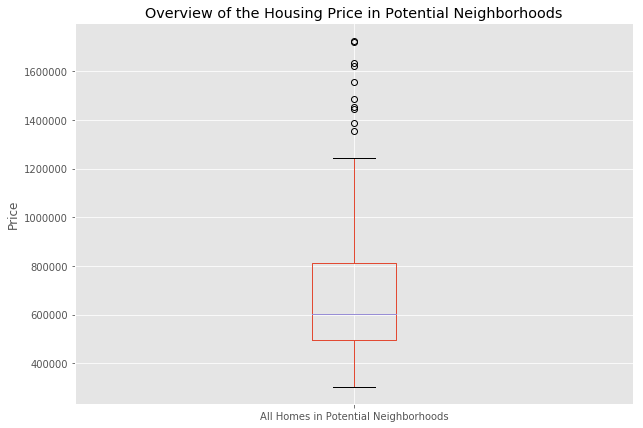

,Zillow Home Value Index_Allhomes
count,1.180000e+02
mean,7.151314e+05
std,3.198281e+05
min,3.041000e+05
25%,4.949500e+05
50%,6.005500e+05
75%,8.136000e+05
max,1.726200e+06


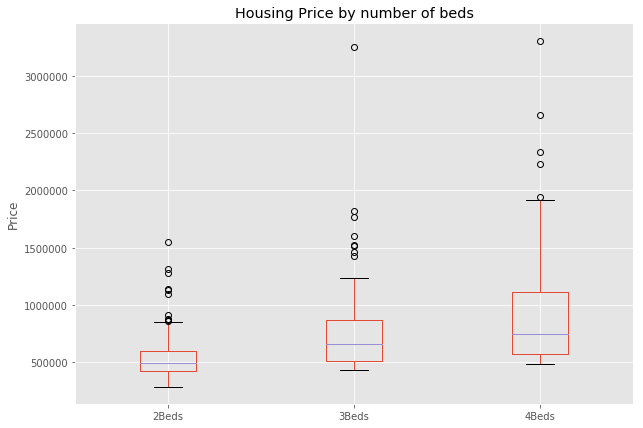

,Zillow Home Value Index_2bed,Zillow Home Value Index_3bed,Zillow Home Value Index_4bed
count,1.120000e+02,1.160000e+02,1.100000e+02
mean,5.581170e+05,7.630319e+05,9.241709e+05
std,2.196553e+05,3.765757e+05,4.981404e+05
min,2.891000e+05,4.289000e+05,4.823000e+05
25%,4.237000e+05,5.139000e+05,5.697500e+05
50%,4.910000e+05,6.619000e+05,7.474000e+05
75%,5.973750e+05,8.696500e+05,1.115550e+06
max,1.553300e+06,3.252700e+06,3.305600e+06


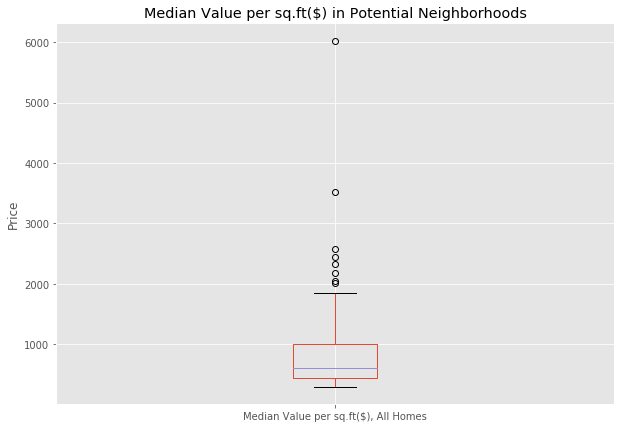

,Median Value per sq.ft($)_Allhomes
count,118.000000
mean,865.169492
std,740.675602
min,296.000000
25%,444.250000
50%,610.000000
75%,1007.750000
max,6027.000000


In [29]:
##Overview of the Housing Prices in potential neighborhoods
sd_housing_data_allhomes = sd_housing_data[['Zillow Home Value Index_Allhomes']]

#Boxplot
sd_housing_data_allhomes.plot(kind='box', figsize=(10,7))
plt.title('Overview of the Housing Price in Potential Neighborhoods')
plt.ylabel('Price')
plt.xticks([1], ['All Homes in Potential Neighborhoods'])
plt.show()
display(sd_housing_data_allhomes.describe())

print('\n')

##Overview of the Housing Prices in potential neighborhoods by number of bedrooms 
sd_housing_data_beds = sd_housing_data.drop(columns=['Zillow Home Value Index_Allhomes','Median Value per sq.ft($)_Allhomes'])

#Boxplot
sd_housing_data_beds.plot(kind='box', figsize=(10,7))
plt.title('Housing Price by number of beds')
plt.ylabel('Price')
plt.xticks([1,2,3], ['2Beds', '3Beds', '4Beds'])
plt.show()
display(sd_housing_data_beds.describe())

print('\n')

##Median Value per sq.ft($) in potential neighborhoods
sd_housing_data_sqft = sd_housing_data[['Median Value per sq.ft($)_Allhomes']]

#Boxplot
sd_housing_data_sqft.plot(kind='box', figsize=(10,7))
plt.title('Median Value per sq.ft($) in Potential Neighborhoods')
plt.ylabel('Price')
plt.xticks([1], ['Median Value per sq.ft($), All Homes'])
plt.show()
display(sd_housing_data_sqft.describe())

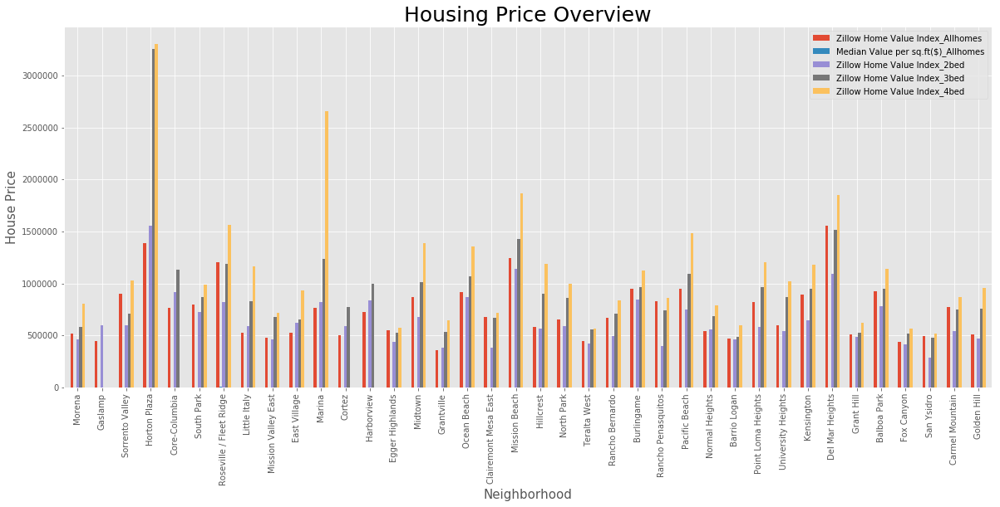

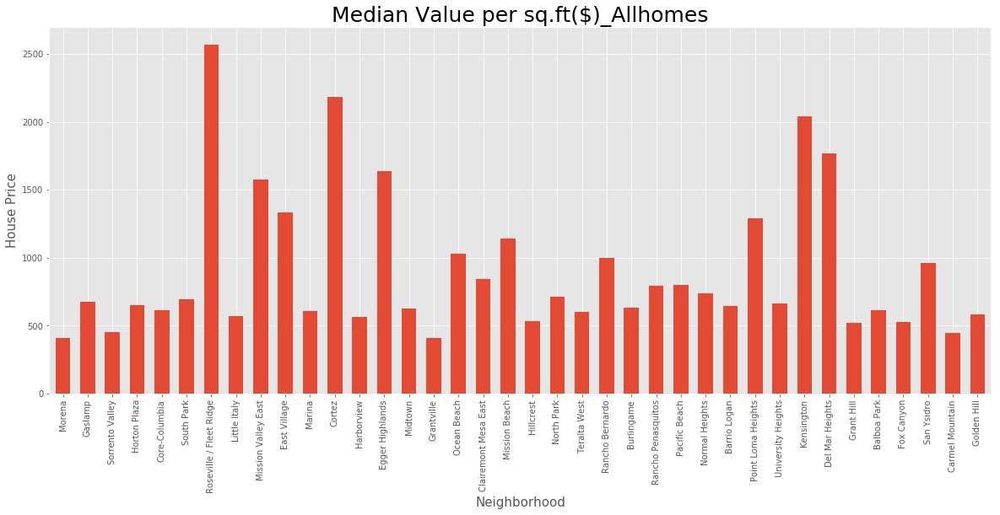

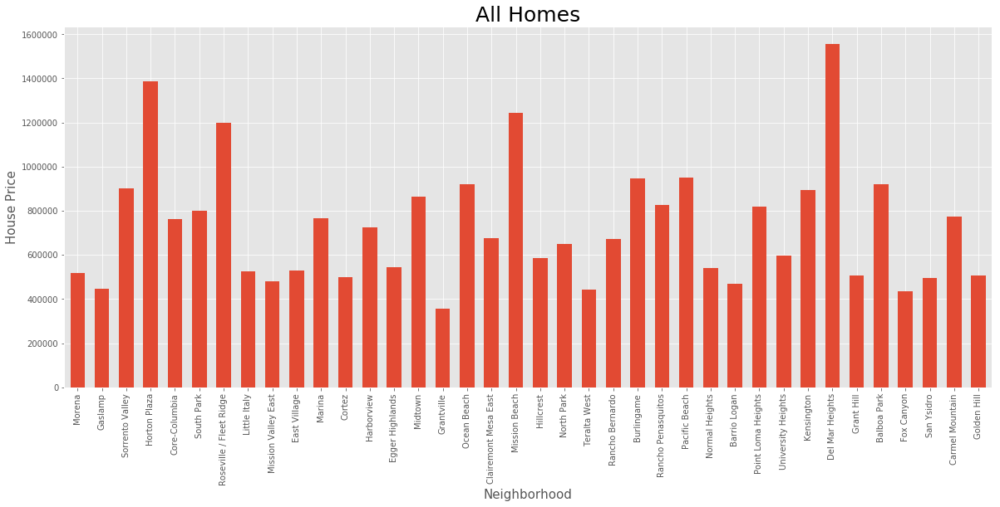

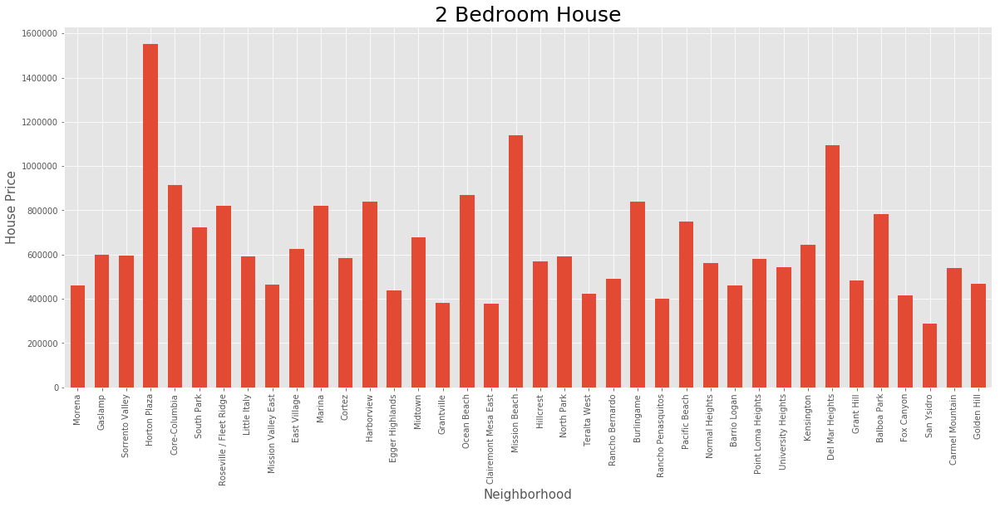

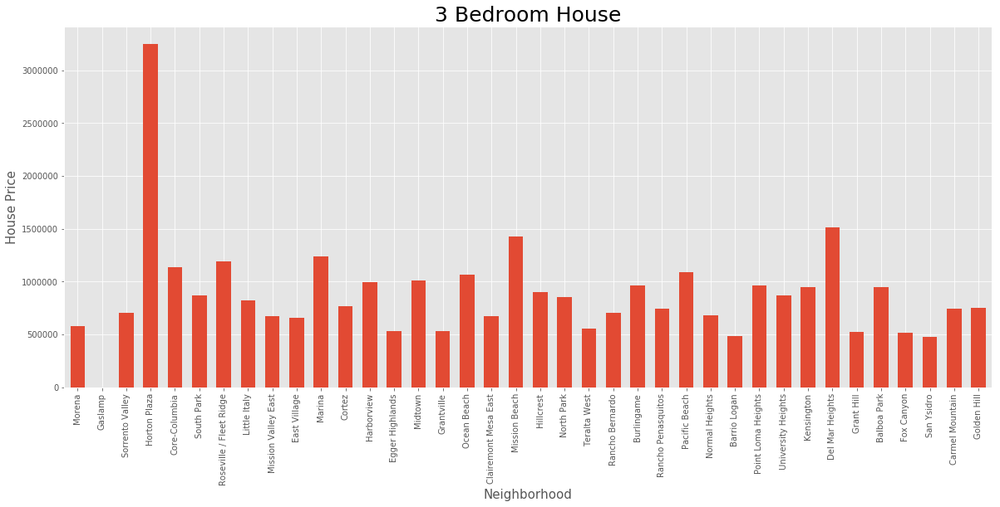

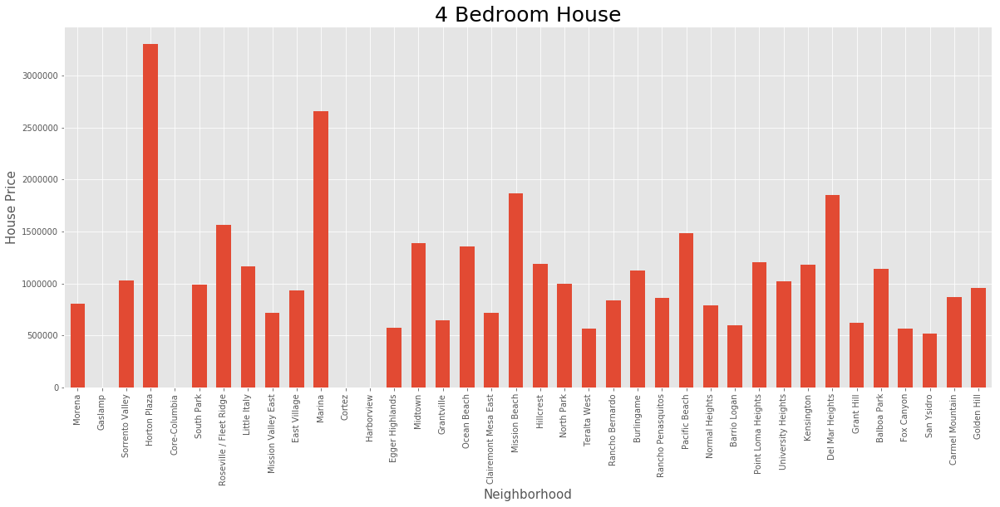

In [30]:
#drop latitude & longitude for chart data
sd_housing_charts_df = final_sd_housing.drop(columns=['Latitude','Longitude'])

#plot a whole dataframe to a bar plot - OVERVIEW
ax_sd_housing = sd_housing_charts_df.plot(kind='bar', figsize=(20,8), width=0.6)
ax_sd_housing.set_title("Housing Price Overview", fontsize=25)
#ax_sd_housing.set_facecolor('white')
#ax_sd_housing.grid(color='grey')
plt.ylabel("House Price", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show()

print('\n')

#plot EACH CATEGORY
ax_persq = sd_housing_charts_df['Median Value per sq.ft($)_Allhomes'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_persq.set_title("Median Value per sq.ft($)_Allhomes", fontsize=25)
plt.ylabel("House Price", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_persq)

print('\n')

ax_allhomes = sd_housing_charts_df['Zillow Home Value Index_Allhomes'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_allhomes.set_title("All Homes", fontsize=25)
plt.ylabel("House Price", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_allhomes)

print('\n')

ax_2bed = sd_housing_charts_df['Zillow Home Value Index_2bed'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_2bed.set_title("2 Bedroom House", fontsize=25)
plt.ylabel("House Price", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_2bed)

print('\n')

ax_3bed = sd_housing_charts_df['Zillow Home Value Index_3bed'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_3bed.set_title("3 Bedroom House", fontsize=25)
plt.ylabel("House Price", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_3bed)

print('\n')

ax_4bed = sd_housing_charts_df['Zillow Home Value Index_4bed'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_4bed.set_title("4 Bedroom House", fontsize=25)
plt.ylabel("House Price", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_4bed)

**Horton Plaza is out of the budget range, and Del Mar Heights also is a bit over the budget**

In [31]:
final_sd_housing_reindexed = final_sd_housing.reset_index()#for mapping

from folium import FeatureGroup, LayerControl, Map, Marker
from folium import plugins

# create map
sd_map_housing = folium.Map(location=[sd_latitude, sd_longitude], zoom_start=12)

#Groups
fg_n = folium.FeatureGroup(name='Neighborhoods')
sd_map_housing.add_child(fg_n)

#fg_ah = folium.plugins.FeatureGroupSubGroup(fg_n, 'All Homes')
fg_ah = folium.FeatureGroup(name='All Homes')
sd_map_housing.add_child(fg_ah)

#fg_2b = folium.plugins.FeatureGroupSubGroup(fg_n, '2Bed')
fg_2b = folium.FeatureGroup(name='2Bed')
sd_map_housing.add_child(fg_2b)

#fg_3b = folium.plugins.FeatureGroupSubGroup(fg_n, '3Bed')
fg_3b = folium.FeatureGroup(name='3Bed')
sd_map_housing.add_child(fg_3b)

#fg_4b = folium.plugins.FeatureGroupSubGroup(fg_n, '4Bed')
fg_4b = folium.FeatureGroup(name='4Bed')
sd_map_housing.add_child(fg_4b)


#Add markers for neighborhood, all homes, 2bed, 3bed, 4bed
for n_lat, n_lng, n_neighborhood in zip(final_sd_housing_reindexed['Latitude'],
                                        final_sd_housing_reindexed['Longitude'],
                                        final_sd_housing_reindexed['Neighborhood']):
    label = folium.Popup(str(n_neighborhood), parse_html=True)
    folium.CircleMarker(
            [n_lat, n_lng],
            radius=10,
            popup=label,
            color='blue',
            fill=True,
            fill_color='blue',
            fill_opacity=0.7).add_to(fg_n)

for ah_lat, ah_lng, ah_price in zip(final_sd_housing_reindexed['Latitude']-0.0001,
                                    final_sd_housing_reindexed['Longitude']-0.0001,
                                    final_sd_housing_reindexed['Zillow Home Value Index_Allhomes']):
    url = 'https://github.com/mhmonac/Coursera_Capstone/raw/master/icons/AllHomes.png'
    icon = folium.features.CustomIcon(url, icon_size=(20,20))
    label = folium.Popup(str(ah_price), parse_html=True)
    folium.Marker(
        [ah_lat, ah_lng],
        icon=icon,
        opacity=0.9,
        popup=label).add_to(fg_ah)
    
for b2_lat, b2_lng, b2_price in zip(final_sd_housing_reindexed['Latitude']-0.0001,
                                    final_sd_housing_reindexed['Longitude']-0.0001,
                                    final_sd_housing_reindexed['Zillow Home Value Index_2bed']):
    url = 'https://github.com/mhmonac/Coursera_Capstone/raw/master/icons/2bed.png'
    icon = folium.features.CustomIcon(url, icon_size=(20,20))
    label = folium.Popup(str(b2_price), parse_html=True)
    folium.Marker(
        [b2_lat, b2_lng],
        icon=icon,
        opacity=0.9,
        popup=label).add_to(fg_2b)
    
for b3_lat, b3_lng, b3_price in zip(final_sd_housing_reindexed['Latitude']-0.0001,
                                    final_sd_housing_reindexed['Longitude']-0.0001,
                                    final_sd_housing_reindexed['Zillow Home Value Index_3bed']):
    url = 'https://github.com/mhmonac/Coursera_Capstone/raw/master/icons/3bed.png'
    icon = folium.features.CustomIcon(url, icon_size=(20,20))
    label = folium.Popup(str(b3_price), parse_html=True)
    folium.Marker(
        [b3_lat, b3_lng],
        icon=icon,
        opacity=0.9,
        popup=label).add_to(fg_3b)

for b4_lat, b4_lng, b4_price in zip(final_sd_housing_reindexed['Latitude']-0.0001,
                                    final_sd_housing_reindexed['Longitude']-0.0001,
                                    final_sd_housing_reindexed['Zillow Home Value Index_4bed']):
    url = 'https://github.com/mhmonac/Coursera_Capstone/raw/master/icons/4bed.png'
    icon = folium.features.CustomIcon(url, icon_size=(20,20))
    label = folium.Popup(str(b4_price), parse_html=True)
    folium.Marker(
        [b4_lat, b4_lng],
        icon=icon,
        opacity=0.9,
        popup=label).add_to(fg_4b)

LayerControl(collapsed=False).add_to(sd_map_housing)

sd_map_housing

#reference: https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/Plugins.ipynb#Sub-categories

## EXPLORE & ANALYZE NEIGHBORHOODS BY CRIME RATE - SAN DIEGO

### DATA

In [33]:
#file = "https://www.sandiego.gov/sites/default/files/201908cumneighborhood.pdf" 
#above file is a pdf, and I was going to use Camelot to read it. However, the site does not 
#allow for you to read the file directly(http error 403:Forbidden). So, I converted this pdf
#file to excel online, using ZAMZAR. I got the download link from ZAMZAR after converting the file

#raw data
sd_crime_raw = pd.ExcelFile('https://github.com/mhmonac/Coursera_Capstone/raw/master/icons/201908cumneighborhood.xlsx')
sd_crime_raw_p1 = pd.read_excel(sd_crime_raw, sheet_name='Page 1', index_col=0, skiprows=6)
sd_crime_raw_p1 = sd_crime_raw_p1.reset_index()
sd_crime_raw_p2 = pd.read_excel(sd_crime_raw, sheet_name='Page 2', index_col=0, skiprows=6)
sd_crime_raw_p2 = sd_crime_raw_p2.reset_index()
sd_crime_raw_p3 = pd.read_excel(sd_crime_raw, sheet_name='Page 3', index_col=0, skiprows=6)
sd_crime_raw_p3 = sd_crime_raw_p3.reset_index()
sd_crime_raw_p4 = pd.read_excel(sd_crime_raw, sheet_name='Page 4', index_col=0, skiprows=6)
sd_crime_raw_p4 = sd_crime_raw_p4.reset_index()
#we reset_index here, otherwise we get Error: Shape of passed values is (132, 68), indices imply (131, 68)


#merge using .append method(because all the columns are the same, we're only combining rows)
sd_crime_data = sd_crime_raw_p1.append([sd_crime_raw_p2, sd_crime_raw_p3, sd_crime_raw_p4])

#reindex & drop current index
sd_crime_data.reset_index(drop=True, inplace=True)

sd_crime_data.head()

,Neighborhood,MURDER,RAPE,RAPE.1,ARMED,ST/,ASSAULT,CRM TL,RESID,NRESID,TOTAL,$400+,Unnamed: 12,TOTAL.1,THEFT,CRM TL.1,IDX TL,PROWL
0,NaN,NaN,NaN,(HISTORICAL),NaN,ARM,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,*************,NaN,NaN,NaN,NaN,NaN,NaN,NaN,*************,*************,NaN
2,Agency = SAN DIEGO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,ADAMS NORTH,0.0,1.0,1,1.0,6,4,12,2,1,3,19,24,43,9,55,67,16
4,ALLIED GARDENS,0.0,3.0,2,0.0,0,8,11,19,6,25,32,37,69,18,112,123,35


### DATA CLEANING

In [34]:
#drop NaN(Neighborhood) rows & other rows that are not needed by index
sd_crime_data.drop([0,1,2,35,36,37,71,72,73,107,108,109,140], inplace=True)
sd_crime_data.reset_index(drop=True, inplace=True)
sd_crime_data

#combine columns-e.g. Rape&Rape1 / armed robbery&strong arm robbery etc.
#check dtypes of each columns
sd_crime_data.dtypes
#convert all columns to float except for 'Neighborhood'
sd_cols=[i for i in sd_crime_data.columns if i not in ["Neighborhood"]]
for col in sd_cols:
    sd_crime_data[col] = pd.to_numeric(sd_crime_data[col], errors='coerce')
#ST/ column did not get converted to float, but integer instead.
sd_crime_data['ST/'] = sd_crime_data['ST/'].astype(float)
#combine data
sd_crime_data['RAPE_sum'] = sd_crime_data['RAPE'] + sd_crime_data['RAPE.1']
sd_crime_data['ROBBERY_sum'] = sd_crime_data['ARMED'] + sd_crime_data['ST/']
sd_crime_data.drop(columns=['RAPE', 'RAPE.1', 'ARMED', 'ST/'], inplace=True)

#rename the new dataframe columns
sd_crime_data.columns = ['Neighborhood','MURDER', 'AGGRAVATED ASSAULT', 'TOTAL VIOLENT CRIME',
                         'RESIDENTIAL BURGLARY', 'NON-RESIDENTIAL BURGLARY', 'TOTAL BURGLARY',
                         'THEFT $400+', 'THEFT<$400', 'TOTAL THEFTS', 'MOTOR VEHICLE THEFT', 'TOTAL PROPERTY CRIME', 
                         'CRIME INDEX TOTAL', 'PROWL', 'RAPE', 'ROBBERY']
#re-organize - put RAPE and ROBBERY columns between MURDER and AGGRAVATED ASSAULT
sd_crime_data = sd_crime_data[['Neighborhood','MURDER', 'RAPE', 'ROBBERY', 'AGGRAVATED ASSAULT', 'TOTAL VIOLENT CRIME',
                  'RESIDENTIAL BURGLARY', 'NON-RESIDENTIAL BURGLARY', 'TOTAL BURGLARY',
                  'THEFT $400+', 'THEFT<$400', 'TOTAL THEFTS', 'MOTOR VEHICLE THEFT', 'TOTAL PROPERTY CRIME',
                  'CRIME INDEX TOTAL', 'PROWL']]

#drop UNKNOWN & SUBTOTAL & GRAND TOTALS RAWS
sd_crime_data.drop([125,126,127], inplace=True)


sd_crime_data.head()

,Neighborhood,MURDER,RAPE,ROBBERY,AGGRAVATED ASSAULT,TOTAL VIOLENT CRIME,RESIDENTIAL BURGLARY,NON-RESIDENTIAL BURGLARY,TOTAL BURGLARY,THEFT $400+,THEFT<$400,TOTAL THEFTS,MOTOR VEHICLE THEFT,TOTAL PROPERTY CRIME,CRIME INDEX TOTAL,PROWL
0,ADAMS NORTH,0.0,2.0,7.0,4.0,12.0,2.0,1.0,3.0,19.0,24.0,43.0,9.0,55.0,67.0,16.0
1,ALLIED GARDENS,0.0,5.0,0.0,8.0,11.0,19.0,6.0,25.0,32.0,37.0,69.0,18.0,112.0,123.0,35.0
2,ALTA VISTA,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,4.0,5.0,1.0,7.0,7.0,3.0
3,AZALEA/HOLLYWOOD PARK,0.0,2.0,1.0,10.0,12.0,3.0,0.0,3.0,8.0,7.0,15.0,7.0,25.0,37.0,7.0
4,BALBOA PARK,0.0,5.0,7.0,10.0,21.0,1.0,6.0,7.0,69.0,23.0,92.0,11.0,110.0,131.0,25.0


In [35]:
#Total Violent Crime equals the sum of murders, rapes, robberies, and aggravated assaults.
#Total Burglary equals the sum of residential and non-residential burglaries.
#Total Thefts equals the sum of thefts >= $400 and thefts < $400.
#Total Property Crime equals the sum of Total Burglary, Total Thefts, and motor vehicle thefts.
#Crime Index Total equals the sum of Total Violent Crime and Total Property Crime.

##final crime dataframe i want
sd_crime_data_final = sd_crime_data[['Neighborhood', 'TOTAL VIOLENT CRIME', 'TOTAL BURGLARY', 'TOTAL THEFTS',
                                   'TOTAL PROPERTY CRIME', 'CRIME INDEX TOTAL']]
sd_crime_data_final

,Neighborhood,TOTAL VIOLENT CRIME,TOTAL BURGLARY,TOTAL THEFTS,TOTAL PROPERTY CRIME,CRIME INDEX TOTAL
0,ADAMS NORTH,12.0,3.0,43.0,55.0,67.0
1,ALLIED GARDENS,11.0,25.0,69.0,112.0,123.0
2,ALTA VISTA,0.0,1.0,5.0,7.0,7.0
3,AZALEA/HOLLYWOOD PARK,12.0,3.0,15.0,25.0,37.0
4,BALBOA PARK,21.0,7.0,92.0,110.0,131.0
5,BARRIO LOGAN,54.0,8.0,82.0,132.0,186.0
6,BAY HO,9.0,10.0,62.0,86.0,95.0
7,BAY PARK,26.0,24.0,161.0,210.0,236.0
8,BAY TERRACES,48.0,28.0,92.0,180.0,228.0
9,BIRDLAND,19.0,12.0,39.0,62.0,81.0


In [36]:
##match 'Neighborhood names - Capitalize first letter of each word'
sd_crime_data_final['Neighborhood'] = sd_crime_data_final['Neighborhood'].str.title()
display(sd_crime_data_final.head())

#choose only the neighborhoods I'm interested in
sd_crime_data_final_reindexed = sd_crime_data_final.set_index('Neighborhood')
sd_crime_selected_neighborhoods = sd_crime_data_final_reindexed.loc[sd_housing_merged_col_names]
display(sd_crime_selected_neighborhoods)

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


,Neighborhood,TOTAL VIOLENT CRIME,TOTAL BURGLARY,TOTAL THEFTS,TOTAL PROPERTY CRIME,CRIME INDEX TOTAL
0,Adams North,12.0,3.0,43.0,55.0,67.0
1,Allied Gardens,11.0,25.0,69.0,112.0,123.0
2,Alta Vista,0.0,1.0,5.0,7.0,7.0
3,Azalea/Hollywood Park,12.0,3.0,15.0,25.0,37.0
4,Balboa Park,21.0,7.0,92.0,110.0,131.0


,TOTAL VIOLENT CRIME,TOTAL BURGLARY,TOTAL THEFTS,TOTAL PROPERTY CRIME,CRIME INDEX TOTAL
Neighborhood,,,,,
Morena,22.0,47.0,120.0,189.0,211.0
Gaslamp,64.0,10.0,179.0,202.0,266.0
Sorrento Valley,4.0,30.0,55.0,96.0,100.0
Horton Plaza,25.0,3.0,40.0,45.0,70.0
Core-Columbia,105.0,27.0,249.0,304.0,409.0
South Park,6.0,5.0,51.0,74.0,80.0
Roseville / Fleet Ridge,15.0,13.0,50.0,86.0,101.0
Little Italy,17.0,10.0,97.0,124.0,141.0
Mission Valley East,56.0,72.0,533.0,698.0,754.0


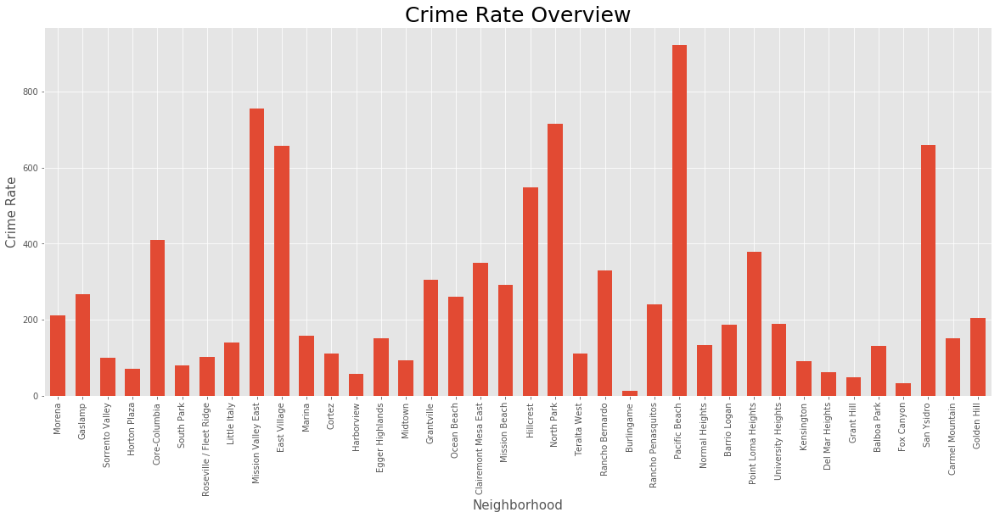

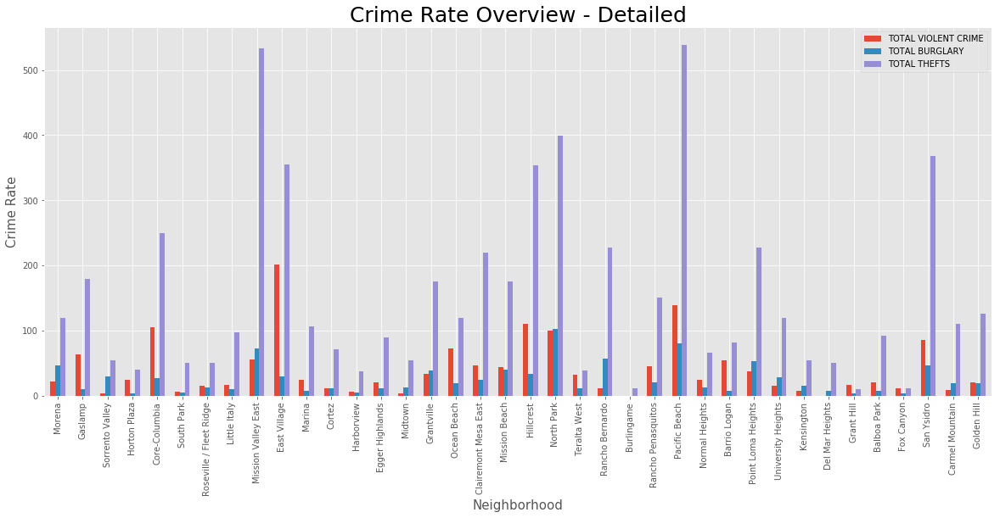

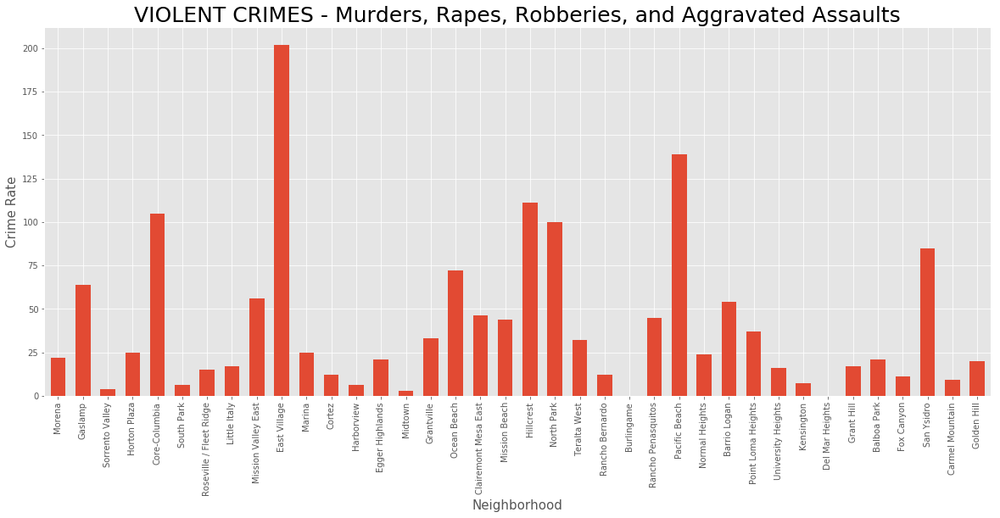

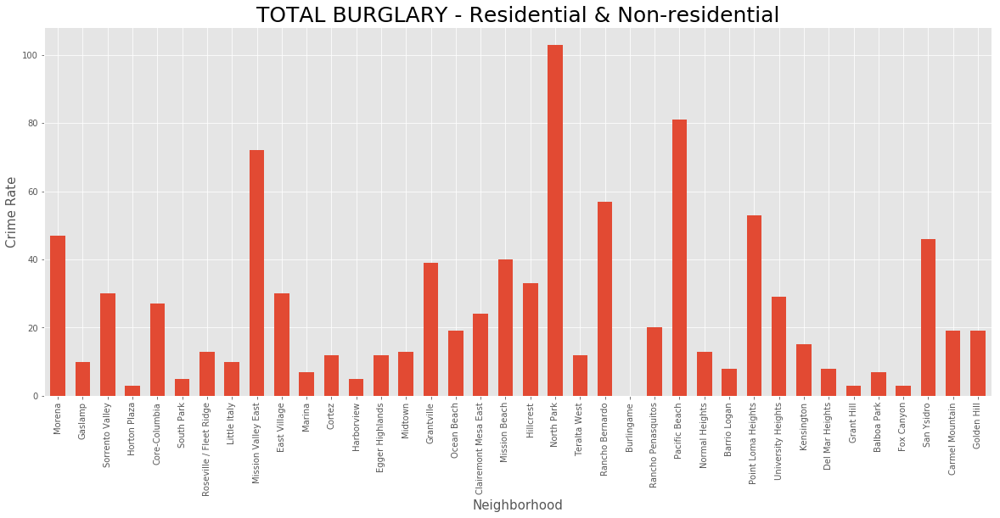

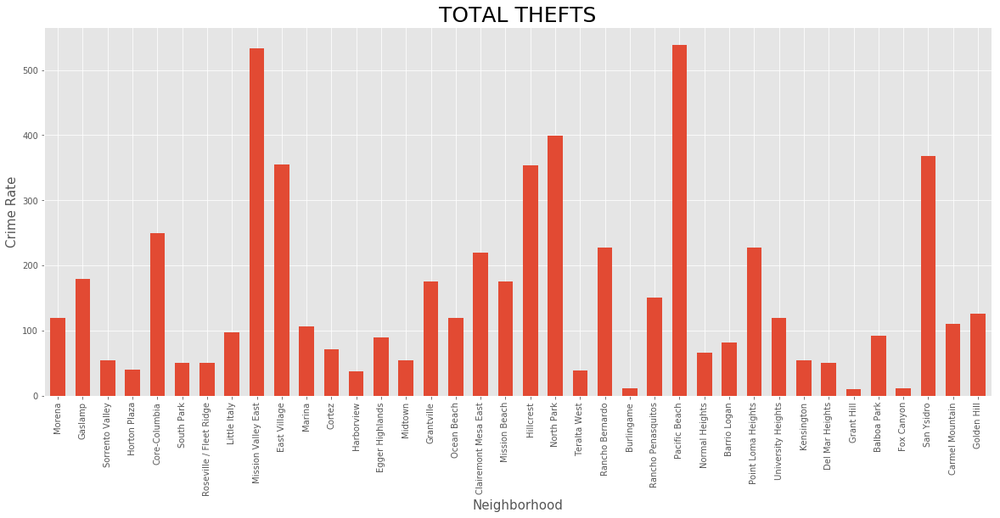

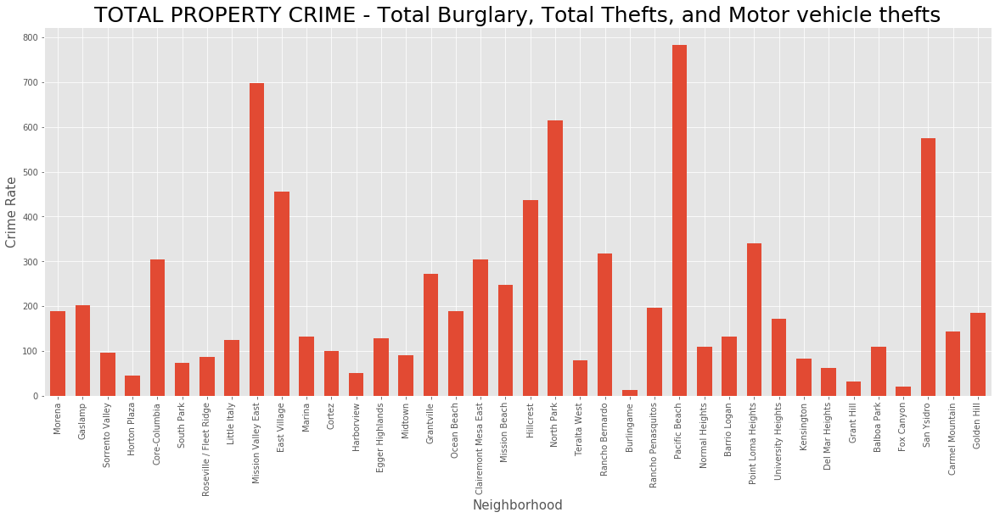

In [37]:
#plot a whole dataframe to a bar plot - OVERVIEW
ax_sd_crime = sd_crime_selected_neighborhoods['CRIME INDEX TOTAL'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_sd_crime.set_title("Crime Rate Overview", fontsize=25)
#ax_sd_crime_BD.set_facecolor('white')
#ax_sd_crime_BD.grid(color='grey')
plt.ylabel("Crime Rate", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_sd_crime)

print('\n')

#plot a whole dataframe to a bar plot - OVERVIEW BREAKDOWN
sd_crime_BD = sd_crime_selected_neighborhoods[['TOTAL VIOLENT CRIME','TOTAL BURGLARY','TOTAL THEFTS']].copy()
ax_sd_crime_BD = sd_crime_BD.plot(kind='bar', figsize=(20,8), width=0.6)
ax_sd_crime_BD.set_title("Crime Rate Overview - Detailed", fontsize=25)
#ax_sd_crime_BD.set_facecolor('white')
#ax_sd_crime_BD.grid(color='grey')
plt.ylabel("Crime Rate", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_sd_crime_BD)

print('\n')

#plot EACH CATEGORY
ax_tvc = sd_crime_selected_neighborhoods['TOTAL VIOLENT CRIME'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_tvc.set_title("VIOLENT CRIMES - Murders, Rapes, Robberies, and Aggravated Assaults", fontsize=25)
plt.ylabel("Crime Rate", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_tvc)

print('\n')

ax_tb = sd_crime_selected_neighborhoods['TOTAL BURGLARY'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_tb.set_title("TOTAL BURGLARY - Residential & Non-residential", fontsize=25)
plt.ylabel("Crime Rate", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_tb)

print('\n')

ax_tth = sd_crime_selected_neighborhoods['TOTAL THEFTS'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_tth.set_title("TOTAL THEFTS", fontsize=25)
plt.ylabel("Crime Rate", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_tth)

print('\n')

ax_tpc = sd_crime_selected_neighborhoods['TOTAL PROPERTY CRIME'].plot(kind='bar', figsize=(20,8), width=0.6)
ax_tpc.set_title("TOTAL PROPERTY CRIME - Total Burglary, Total Thefts, and Motor vehicle thefts", fontsize=25)
plt.ylabel("Crime Rate", fontsize=15)
plt.xlabel("Neighborhood", fontsize=15)
plt.show(ax_tpc)

In [38]:
#identify the missing data in the map and fix it
sd_crime_data_final['Neighborhood'].replace({'College Area West':'College West', 
                                             'College Area East':'College East',
                                             'Fairmount Village':'Fairmont Village',
                                             'Fairmount Park':'Fairmont Park',
                                            'Jamacha/Lomita':'Jamacha Lomita',
                                            'Mt. Hope':'Mt Hope'}, inplace=True)
sd_crime_data_final.head()

/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/generic.py:6586: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)


,Neighborhood,TOTAL VIOLENT CRIME,TOTAL BURGLARY,TOTAL THEFTS,TOTAL PROPERTY CRIME,CRIME INDEX TOTAL
0,Adams North,12.0,3.0,43.0,55.0,67.0
1,Allied Gardens,11.0,25.0,69.0,112.0,123.0
2,Alta Vista,0.0,1.0,5.0,7.0,7.0
3,Azalea/Hollywood Park,12.0,3.0,15.0,25.0,37.0
4,Balboa Park,21.0,7.0,92.0,110.0,131.0


In [39]:
#create dataframe for each crime
sd_tvc = sd_crime_data_final[['Neighborhood', 'TOTAL VIOLENT CRIME']]
sd_tb = sd_crime_data_final[['Neighborhood', 'TOTAL BURGLARY']]
sd_tth = sd_crime_data_final[['Neighborhood', 'TOTAL THEFTS']]
sd_tpc = sd_crime_data_final[['Neighborhood', 'TOTAL PROPERTY CRIME']]
sd_cit = sd_crime_data_final[['Neighborhood', 'CRIME INDEX TOTAL']]

In [40]:
##Mapping - Choropleth

sd_geo = r'gn-san-diego.geojson'#geojson file

sd_map_crime = folium.Map(location=[sd_latitude, sd_longitude], zoom_start=13)

choropleth_cit = folium.Choropleth(name='Total Crime',
    geo_data=sd_geo,
    data=sd_cit,
    columns=['Neighborhood', 'CRIME INDEX TOTAL'],
    key_on='feature.properties.name',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Crime').add_to(sd_map_crime)


choropleth_tvc = folium.Choropleth(name='Murder, Rapes, Robberies,Aggravated assaults',
    geo_data=sd_geo,
    data=sd_tvc,
    columns=['Neighborhood', 'TOTAL VIOLENT CRIME'],
    key_on='feature.properties.name',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Violent Crime').add_to(sd_map_crime)

choropleth_tb = folium.Choropleth(name='Burglary',
    geo_data=sd_geo,
    data=sd_tb,
    columns=['Neighborhood', 'TOTAL BURGLARY'],
    key_on='feature.properties.name',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Burglary').add_to(sd_map_crime)

choropleth_tth = folium.Choropleth(name='Thefts',
    geo_data=sd_geo,
    data=sd_tth,
    columns=['Neighborhood', 'TOTAL THEFTS'],
    key_on='feature.properties.name',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Thefts').add_to(sd_map_crime)

choropleth_tpc = folium.Choropleth(name='Burglary, Thefts, Motor vehicle thefts',
    geo_data=sd_geo,
    data=sd_tpc,
    columns=['Neighborhood', 'TOTAL PROPERTY CRIME'],
    key_on='feature.properties.name',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Property Crime').add_to(sd_map_crime)

#add labls indicating the name of the neighborhood
style_function = "font-size: 15px; font-weight:bold"
choropleth_cit.geojson.add_child(
    folium.features.GeoJsonTooltip(['name'], style=style_function, labels=False))
choropleth_tpc.geojson.add_child(
    folium.features.GeoJsonTooltip(['name'], style=style_function, labels=False))
choropleth_tvc.geojson.add_child(
    folium.features.GeoJsonTooltip(['name'], style=style_function, labels=False))
choropleth_tb.geojson.add_child(
    folium.features.GeoJsonTooltip(['name'], style=style_function, labels=False))
choropleth_tth.geojson.add_child(
    folium.features.GeoJsonTooltip(['name'], style=style_function, labels=False))

folium.LayerControl().add_to(sd_map_crime)

#Add markers for neighborhood(from housing map)
#fg_n = folium.FeatureGroup(name='Neighborhoods')
#sd_map_housing.add_child(fg_n)
#for n_lat, n_lng, n_neighborhood in zip(final_sd_housing_reindexed['Latitude'],
                                        #final_sd_housing_reindexed['Longitude'],
                                        #final_sd_housing_reindexed['Neighborhood']):
    #label = folium.Popup(str(n_neighborhood), parse_html=True)
    #folium.CircleMarker(
            #[n_lat, n_lng],
            #radius=5,
            #popup=label,
            #color='blue',
            #fill=True,
            #fill_color='blue',
            #fill_opacity=0.7).add_to(sd_map_crime)
    
#Add markers for neighborhoods with 3bed houses
for b3_lat, b3_lng, b3_price in zip(final_sd_housing_reindexed['Latitude'],
                                    final_sd_housing_reindexed['Longitude'],
                                    final_sd_housing_reindexed['Zillow Home Value Index_3bed']):
    url = 'https://github.com/mhmonac/Coursera_Capstone/raw/master/icons/3bed.png'
    icon = folium.features.CustomIcon(url, icon_size=(20,20))
    label = folium.Popup(str(b3_price), parse_html=True)
    folium.Marker(
        [b3_lat, b3_lng],
        icon=icon,
        opacity=0.9,
        popup=label).add_to(sd_map_crime)
    
sd_map_crime